<a href="https://colab.research.google.com/github/mannugram/small-object-detection-/blob/main/smallobjectdetection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Mon Jul 15 07:24:12 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   57C    P8              13W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:

!cp -r "/content/drive/MyDrive/earphones" "/content/earphones"


In [1]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="7lqhyimeEuSufviH8jSc")
project = rf.workspace("amalia123").project("ppe.")
version = project.version(4)
dataset = version.download("yolov8")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.9/76.9 kB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 3.4 MB/s eta 0:00:00
  Attempting uninstall: chardet
    Found existing installation: chardet 5.2.0
    Uninstalling chardet-5.2.0:
      Successfully uninstalled chardet-5.2.0
loading Roboflow workspace...
loading Roboflow project...
[WARNING] we noticed you are downloading a `yolov8` datasets but you don't have `ultralytics` installed. Roboflow `.deploy` supports only models trained with `ultralytics==8.0.196`, to intall it `pip install ultralytics==8.0.196`.



Extracting Dataset Version Zip to PPE.-4 in yolov8:: 100%|██████████| 1612/1612 [00:00<00:00, 2182.50it/s]


In [ ]:
!pip install roboflow
!pip install ultralytics
from roboflow import Roboflow
!pip install ultralytics sahi roboflow





     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 801.6/801.6 kB 12.9 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-

In [ ]:
import os
import shutil

def filter_labels(label_folder, image_folder, filtered_label_folder, filtered_image_folder, keep_classes):
    if not os.path.exists(filtered_label_folder):
        os.makedirs(filtered_label_folder)
    if not os.path.exists(filtered_image_folder):
        os.makedirs(filtered_image_folder)

    for label_file in os.listdir(label_folder):
        if label_file.endswith(".txt"):
            label_path = os.path.join(label_folder, label_file)
            filtered_label_path = os.path.join(filtered_label_folder, label_file)

            with open(label_path, 'r') as file:
                lines = file.readlines()

            filtered_lines = []
            for line in lines:
                class_id = int(line.split()[0])
                if class_id in keep_classes:
                    filtered_lines.append(line)

            if filtered_lines:
                with open(filtered_label_path, 'w') as file:
                    file.writelines(filtered_lines)

                image_file = label_file.replace('.txt', '.jpg')
                shutil.copy(os.path.join(image_folder, image_file), os.path.join(filtered_image_folder, image_file))

if __name__ == "__main__":
    base_path = '/content/PPE.-4'
    filtered_base_path = '/content/filtered'

    subsets = ['train', 'test', 'val']
    keep_classes = [0, 1]  # assuming 0: glasses, 1: earplugs.

    for subset in subsets:
        label_folder = os.path.join(base_path, subset, 'labels')
        image_folder = os.path.join(base_path, subset, 'images')
        filtered_label_folder = os.path.join(filtered_base_path, subset, 'labels')
        filtered_image_folder = os.path.join(filtered_base_path, subset, 'images')

        filter_labels(label_folder, image_folder, filtered_label_folder, filtered_image_folder, keep_classes)


In [ ]:
import os
import shutil

def copy_and_update_labels(src_images_folder, src_labels_folder, dst_images_folder, dst_labels_folder, new_class_id):
    if not os.path.exists(src_images_folder):
        print(f"Source folder does not exist: {src_images_folder}")
        return
    if not os.path.exists(src_labels_folder):
        print(f"Source folder does not exist: {src_labels_folder}")
        return

    if not os.path.exists(dst_images_folder):
        os.makedirs(dst_images_folder)
    if not os.path.exists(dst_labels_folder):
        os.makedirs(dst_labels_folder)

    for root, dirs, files in os.walk(src_images_folder):
        for file in files:
            if file.endswith(('.png', '.jpg', '.jpeg')):
                shutil.copy(os.path.join(root, file), os.path.join(dst_images_folder, file))

    for root, dirs, files in os.walk(src_labels_folder):
        for file in files:
            if file.endswith('.txt'):
                with open(os.path.join(root, file), 'r') as f:
                    lines = f.readlines()
                with open(os.path.join(dst_labels_folder, file), 'w') as f:
                    for line in lines:
                        parts = line.strip().split()
                        parts[0] = str(new_class_id)
                        f.write(' '.join(parts) + '\n')
    print(f"Copied and updated labels from {src_labels_folder} to {dst_labels_folder}")

earphone_path = '/content/earphones'
glasses_path = '/content/filtered'

# combining the dataset to one
combined_dataset_path = '/content/combined_dataset'
train_images = os.path.join(combined_dataset_path, 'train/images')
train_labels = os.path.join(combined_dataset_path, 'train/labels')
val_images = os.path.join(combined_dataset_path, 'val/images')
val_labels = os.path.join(combined_dataset_path, 'val/labels')
test_images = os.path.join(combined_dataset_path, 'test/images')
test_labels = os.path.join(combined_dataset_path, 'test/labels')


os.makedirs(train_images, exist_ok=True)
os.makedirs(train_labels, exist_ok=True)
os.makedirs(val_images, exist_ok=True)
os.makedirs(val_labels, exist_ok=True)
os.makedirs(test_images, exist_ok=True)
os.makedirs(test_labels, exist_ok=True)

 #copy and update labels to combine.py
copy_and_update_labels(os.path.join(earphone_path, 'train/images'), os.path.join(earphone_path, 'train/labels'), train_images, train_labels, 0)
copy_and_update_labels(os.path.join(glasses_path, 'train/images'), os.path.join(glasses_path, 'train/labels'), train_images, train_labels, 1)
copy_and_update_labels(os.path.join(earphone_path, 'val/images'), os.path.join(earphone_path, 'val/labels'), val_images, val_labels, 0)
copy_and_update_labels(os.path.join(glasses_path, 'val/images'), os.path.join(glasses_path, 'val/labels'), val_images, val_labels, 1)
copy_and_update_labels(os.path.join(earphone_path, 'test/images'), os.path.join(earphone_path, 'test/labels'), test_images, test_labels, 0)
copy_and_update_labels(os.path.join(glasses_path, 'test/images'), os.path.join(glasses_path, 'test/labels'), test_images, test_labels, 1)

print("Datasets combined and labels updated successfully.")

#data.yaml file
data_yaml_content = f"""
path: {combined_dataset_path}
train: train/images
val: val/images
test: test/images
nc: 2
names: ['earphones', 'glasses']
"""

data_yaml_path = os.path.join(combined_dataset_path, 'data.yaml')
with open(data_yaml_path, 'w') as file:
    file.write(data_yaml_content)

print(f"data.yaml created at: {data_yaml_path}")


Copied and updated labels from /content/earphones/train/labels to /content/combined_dataset/train/labels
Copied and updated labels from /content/filtered/train/labels to /content/combined_dataset/train/labels
Copied and updated labels from /content/earphones/val/labels to /content/combined_dataset/val/labels
Copied and updated labels from /content/filtered/val/labels to /content/combined_dataset/val/labels
Copied and updated labels from /content/earphones/test/labels to /content/combined_dataset/test/labels
Copied and updated labels from /content/filtered/test/labels to /content/combined_dataset/test/labels
Datasets combined and labels updated successfully.
data.yaml created at: /content/combined_dataset/data.yaml


In [ ]:
!pip install torch
!pip install ultralytics
!pip install --upgrade tensorboard tensorflow
import torch
from ultralytics import YOLO

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 57.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 601.3/601.3 MB 1.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.3/5.3 MB 105.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 95.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 81.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 347.7/347.7 kB 34.2 MB/s eta 0:00:00
  Attempting uninstall: ml-dtypes
    Found existing installation: ml-dtypes 0.2.0
    Uninstalling ml-dtypes-0.2.0:
      Successfully uninstalled ml-dtypes-0.2.0
  Attempting uninstall: h5py
    Found existing installation: h5py 3.9.0
    Uninstalling h5py-3.9.0:
      Successfully uninstalled h5py-3.9.0
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.15.2
    Uninstalling tensorboard-2.15.2:
      Successfully uninstalled tensorboard-2.15.2
  Attempting uninstall: keras
    F

In [ ]:

model = YOLO('/content/yolov8n.pt')

!yolo train model='/content/yolov8n.pt' data='/content/combined_dataset/data.yaml' epochs=100 imgsz=640 lr0=0.01 batch=16 workers=0

model.save('/content/combined_dataset/best_model.pt')


Ultralytics YOLOv8.2.57 🚀 Python-3.10.12 torch-2.3.0+cu121 CPU (Intel Xeon 2.00GHz)
engine/trainer: task=detect, mode=train, model=/content/yolov8n.pt, data=/content/combined_dataset/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=0, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show

In [ ]:
!pip install pillow matplotlib
!pip install sahi


In [ ]:
from ultralytics import YOLO
model = YOLO('/content/runs/detect/train/weights/best.pt')
print(model.names)

{0: 'earphones', 1: 'glasses'}



image 1/1 /content/combined_dataset/test/images/80_jpg.rf.0de078add86ba81b77238f6e3018ac6d.jpg: 640x640 1 earphones, 467.5ms
Speed: 14.6ms preprocess, 467.5ms inference, 14.2ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected earphones with confidence 0.7781029939651489
SAHI Detected earphones with confidence 0.8533387780189514


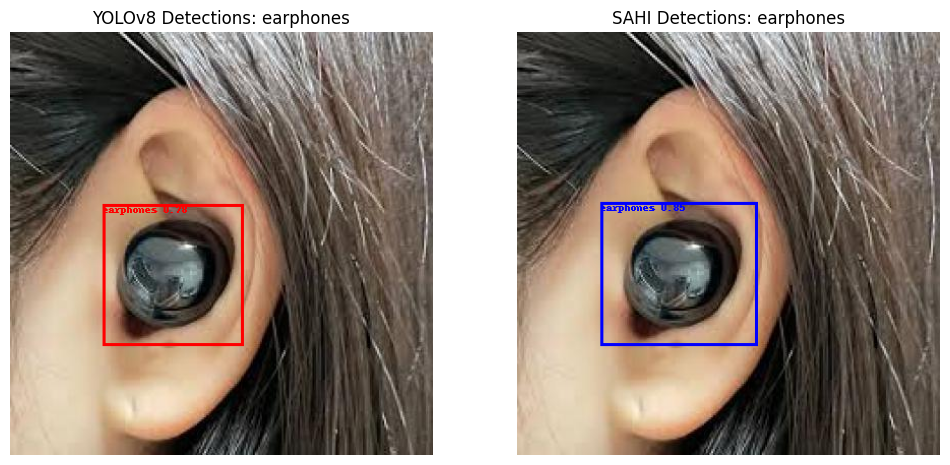


image 1/1 /content/combined_dataset/test/images/gettyimages-1036354066-612x612_jpg.rf.48e643fda0c1c8d0cf5f05cdcf01fa4b.jpg: 640x640 1 glasses, 377.4ms
Speed: 31.7ms preprocess, 377.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.7515787482261658
SAHI Detected glasses with confidence 0.7515787482261658


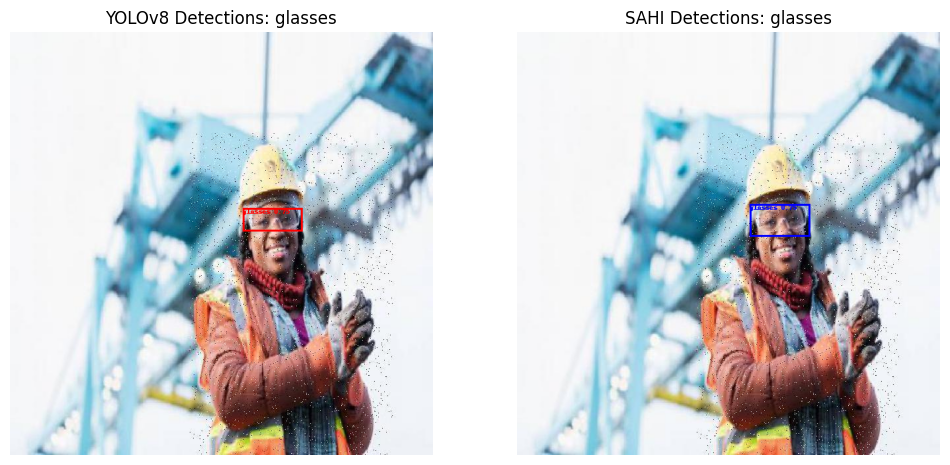


image 1/1 /content/combined_dataset/test/images/135_jpg.rf.10e626998c826b9218fd6fe3da5d5543.jpg: 640x640 1 glasses, 227.6ms
Speed: 3.7ms preprocess, 227.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected glasses with confidence 0.2946307063102722
SAHI Detected glasses with confidence 0.2946307063102722


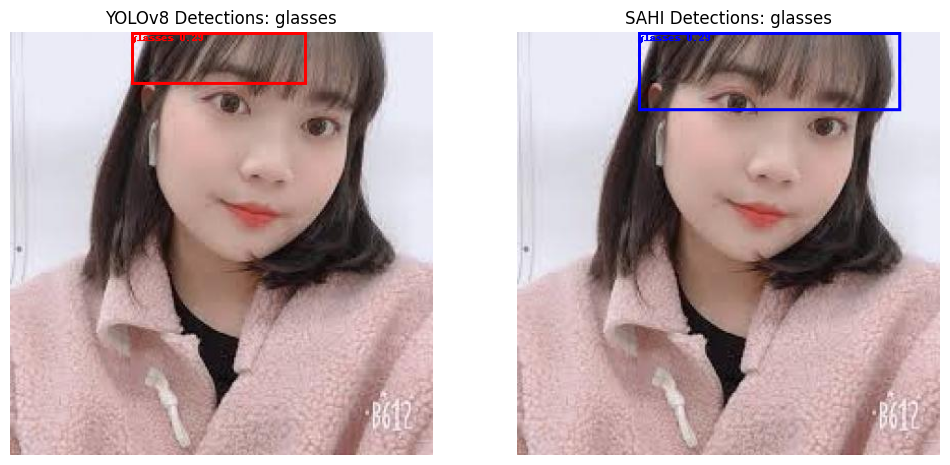


image 1/1 /content/combined_dataset/test/images/32_jpg.rf.8f9d49f315157531897b9a5dac7186eb.jpg: 640x640 (no detections), 256.5ms
Speed: 3.9ms preprocess, 256.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
SAHI Detected glasses with confidence 0.6752137541770935


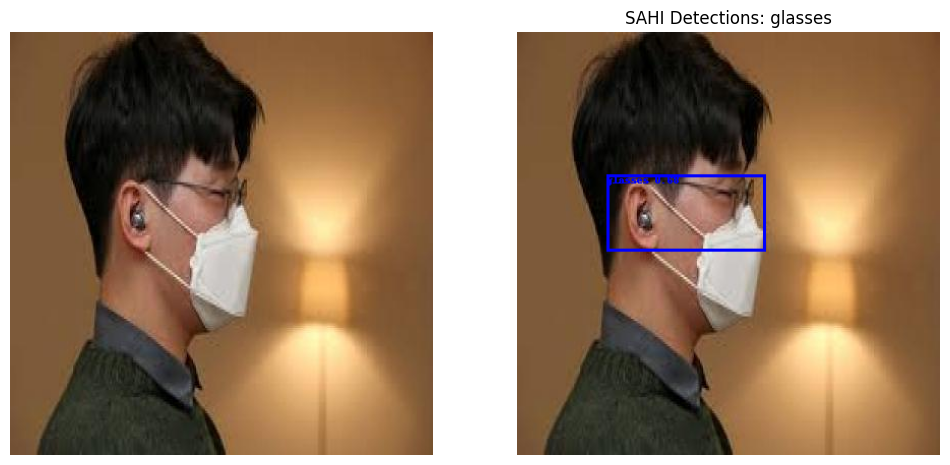


image 1/1 /content/combined_dataset/test/images/0_2--42-_jpg.rf.b044294461b5920a060a36640ef90e98.jpg: 640x640 (no detections), 256.3ms
Speed: 9.8ms preprocess, 256.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.


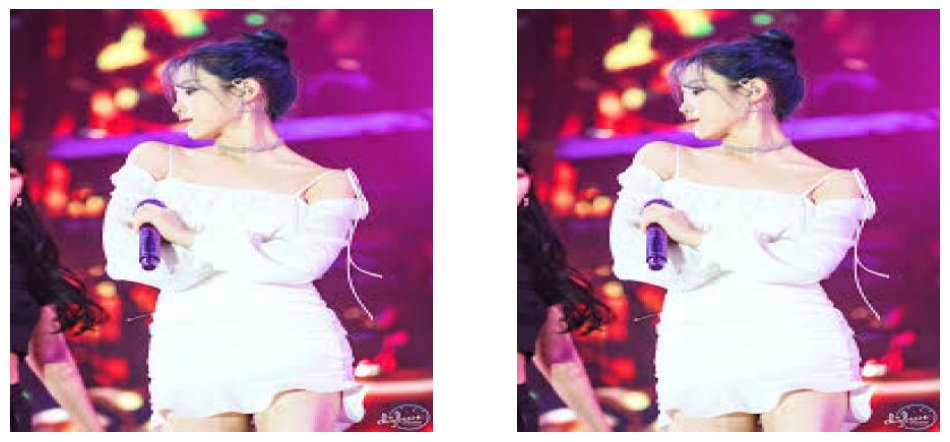


image 1/1 /content/combined_dataset/test/images/48_jpg.rf.150afa7645fef4501057419292c00ca2.jpg: 640x640 (no detections), 240.5ms
Speed: 6.4ms preprocess, 240.5ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
SAHI Detected glasses with confidence 0.27579551935195923


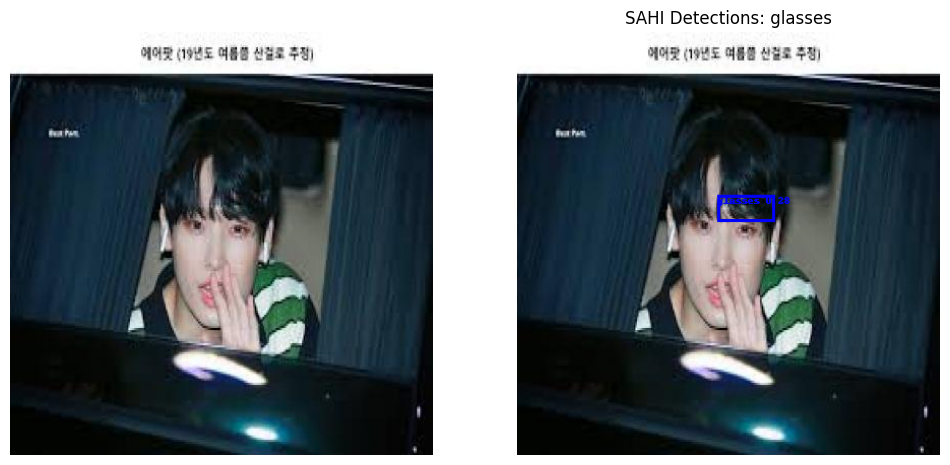


image 1/1 /content/combined_dataset/test/images/37_jpg.rf.59af74397943ccda5bca6b045d35c932.jpg: 640x640 (no detections), 183.0ms
Speed: 4.0ms preprocess, 183.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.


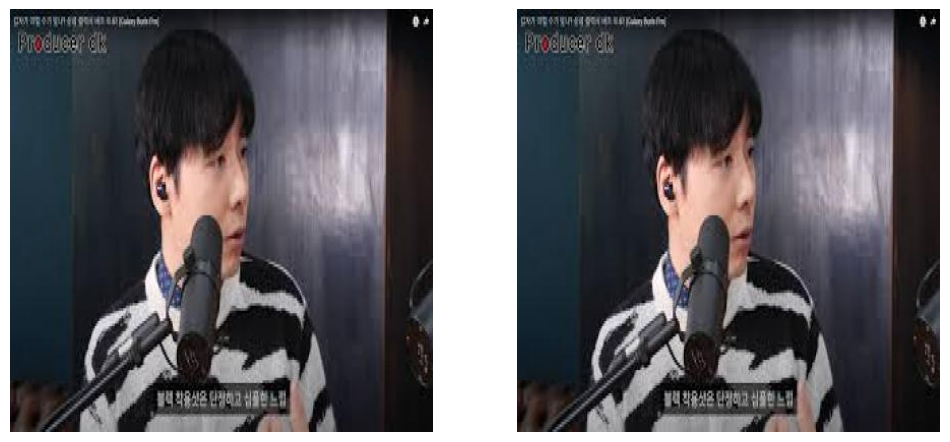


image 1/1 /content/combined_dataset/test/images/Imz-PqQCw5RYcrMcfGTETuJOZbpY_jpg.rf.9f48d844ed131e582984282226d92021.jpg: 640x640 1 earphones, 220.0ms
Speed: 6.7ms preprocess, 220.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected earphones with confidence 0.8266049027442932
SAHI Detected earphones with confidence 0.8266049027442932


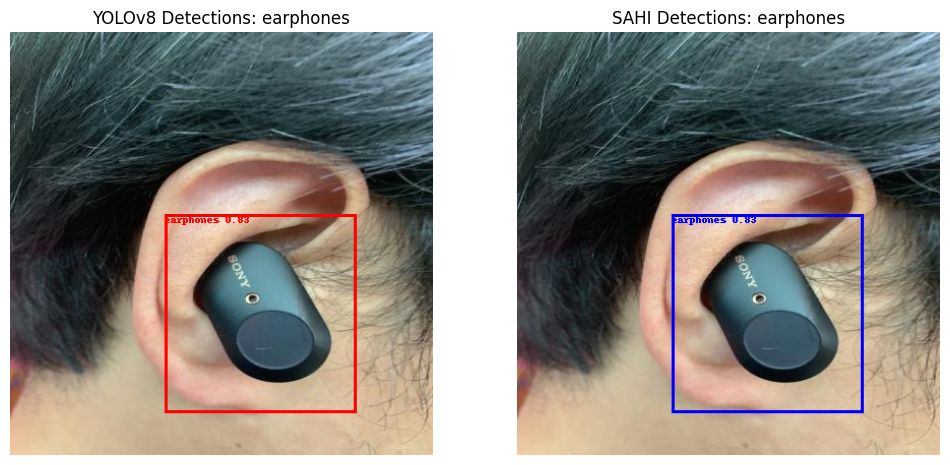


image 1/1 /content/combined_dataset/test/images/45-7106a9129412623a85988c015888e86b_jpg.rf.c081b526b3be11923e25dd2be75879f5.jpg: 640x640 1 earphones, 226.7ms
Speed: 6.5ms preprocess, 226.7ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected earphones with confidence 0.4126434028148651
SAHI Detected earphones with confidence 0.4126434028148651
SAHI Detected glasses with confidence 0.2509259581565857


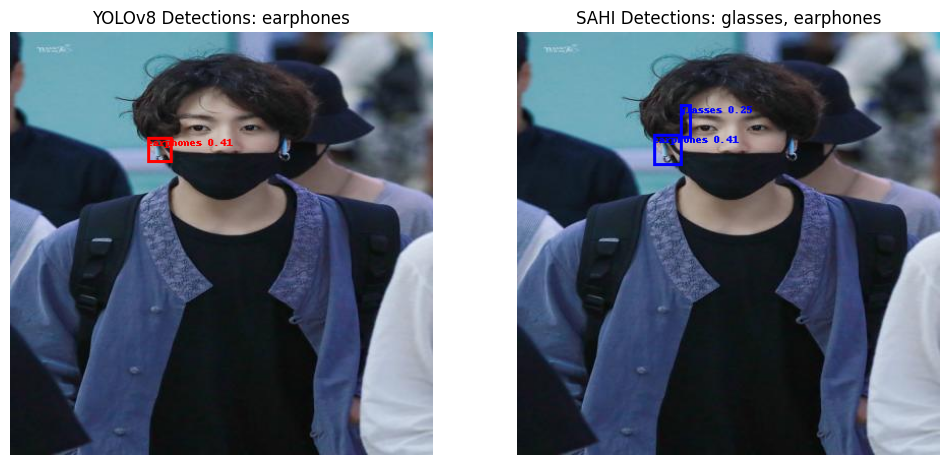


image 1/1 /content/combined_dataset/test/images/gettyimages-1036354066-612x612_jpg.rf.30d425380dab7fd91c47944d31fb158e.jpg: 640x640 1 glasses, 220.5ms
Speed: 2.4ms preprocess, 220.5ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.7305585741996765
SAHI Detected glasses with confidence 0.7305585741996765
SAHI Detected glasses with confidence 0.4827567934989929


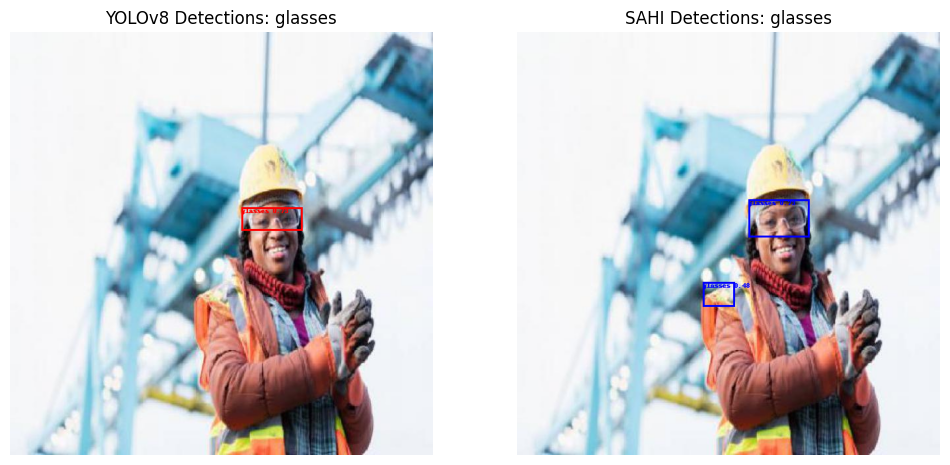


image 1/1 /content/combined_dataset/test/images/12_jpg.rf.a4c70fd98878f38bb1b8c276a16915d2.jpg: 640x640 (no detections), 249.2ms
Speed: 6.4ms preprocess, 249.2ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.


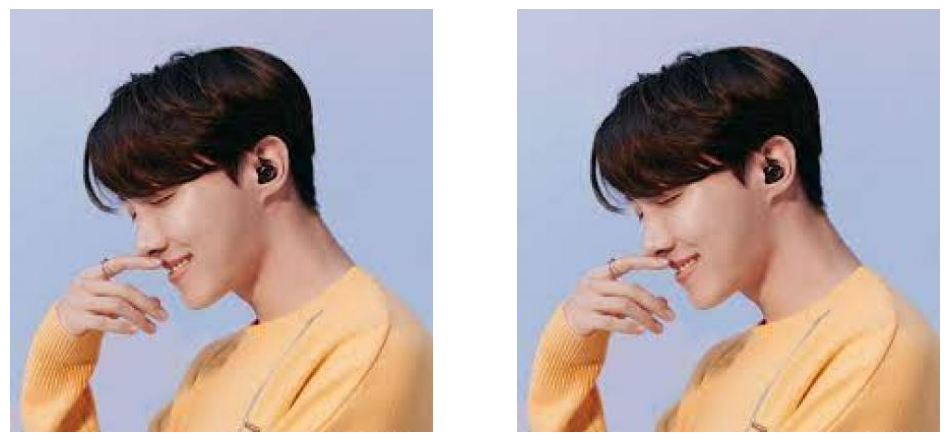


image 1/1 /content/combined_dataset/test/images/istockphoto-1290244425-612x612_jpg.rf.0cf7729ef03a4a1c1969a5385e3b2f0e.jpg: 640x640 1 glasses, 210.8ms
Speed: 2.6ms preprocess, 210.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.8610557913780212
SAHI Detected glasses with confidence 0.8610557913780212


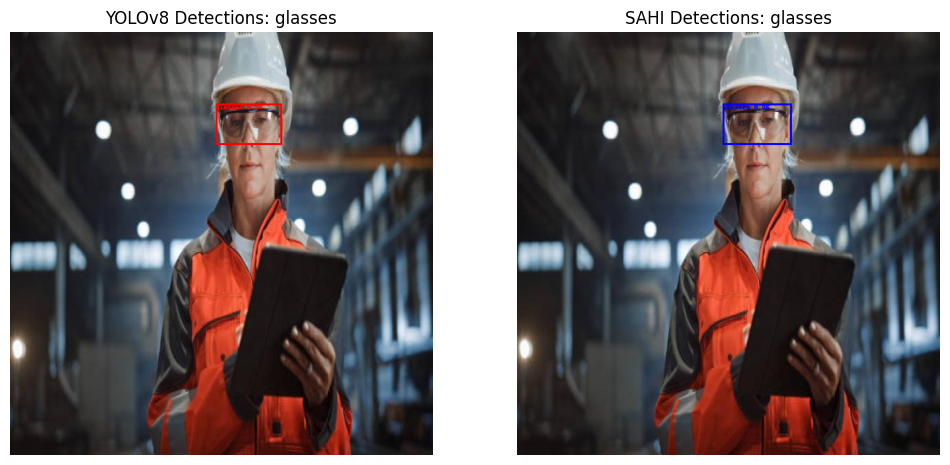


image 1/1 /content/combined_dataset/test/images/image_34_jpg.rf.edaee4d55f78b6b585899ba6fc351225.jpg: 640x640 1 glasses, 243.8ms
Speed: 2.7ms preprocess, 243.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.6299186944961548
SAHI Detected glasses with confidence 0.6299186944961548


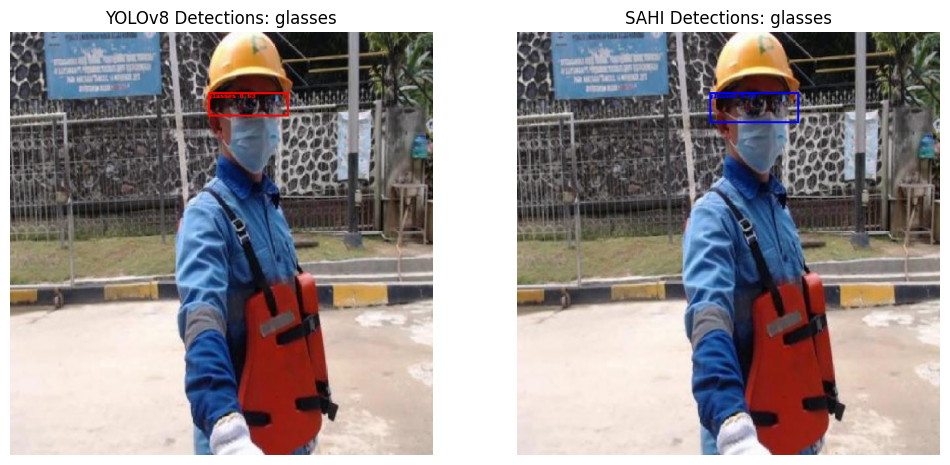


image 1/1 /content/combined_dataset/test/images/image_169_jpg.rf.bdfdb83e568d50ffd9458d5dc240bc6b.jpg: 640x640 1 glasses, 226.6ms
Speed: 2.5ms preprocess, 226.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.621134340763092
SAHI Detected glasses with confidence 0.621134340763092


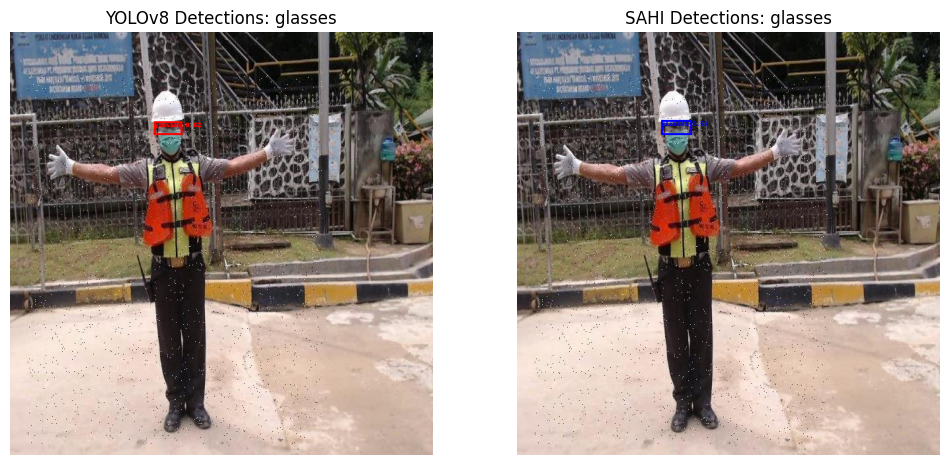


image 1/1 /content/combined_dataset/test/images/23-xhgjh_jpg.rf.2406b715daa837cac5e10f12506f81dc.jpg: 640x640 1 glasses, 223.1ms
Speed: 6.4ms preprocess, 223.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected glasses with confidence 0.5567262768745422
SAHI Detected glasses with confidence 0.5567262768745422


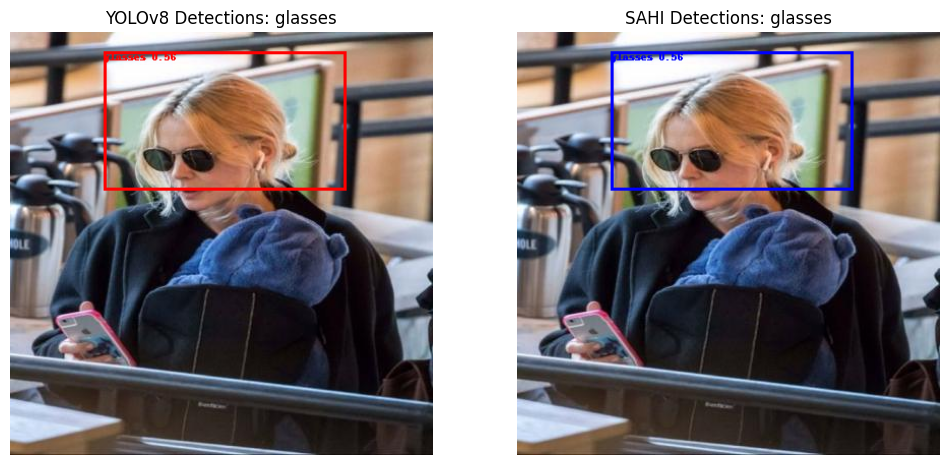


image 1/1 /content/combined_dataset/test/images/0_2--58-_jpg.rf.1c6d03f49f01d0a519e8d1276a27ab0e.jpg: 640x640 1 earphones, 215.4ms
Speed: 6.7ms preprocess, 215.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected earphones with confidence 0.6568317413330078
SAHI Detected earphones with confidence 0.7087926268577576


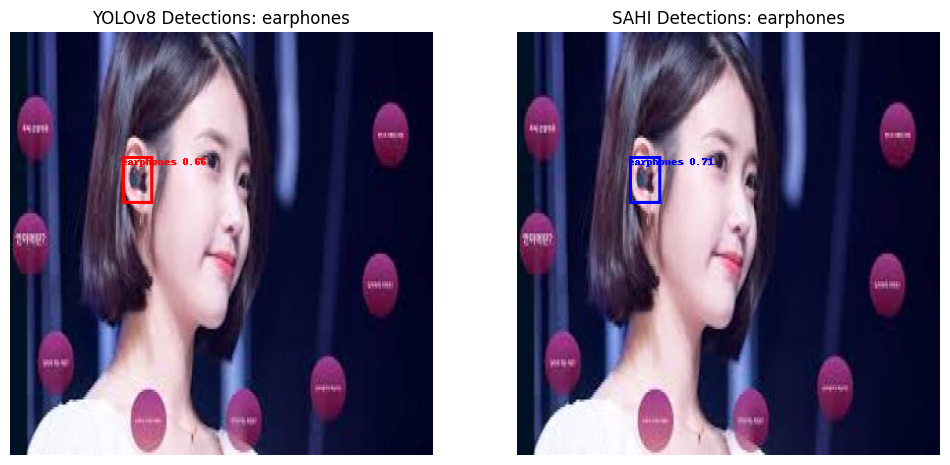


image 1/1 /content/combined_dataset/test/images/0_2--35-_jpg.rf.6e8476e998a6cf9099cb81569f00bf96.jpg: 640x640 (no detections), 223.0ms
Speed: 4.0ms preprocess, 223.0ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.


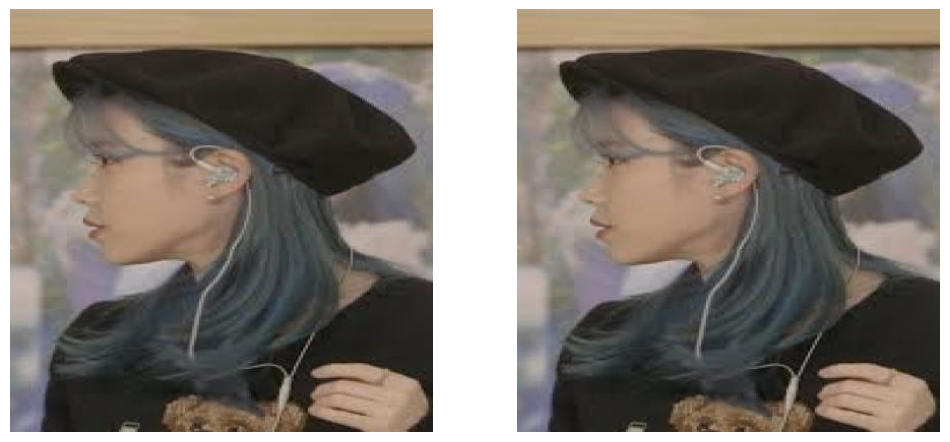


image 1/1 /content/combined_dataset/test/images/construction-worker1_grande_jpg.rf.532ebf7a9a2649378fe3c52568684280.jpg: 640x640 1 glasses, 223.3ms
Speed: 2.7ms preprocess, 223.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.6462923884391785
SAHI Detected glasses with confidence 0.6462923884391785
SAHI Detected glasses with confidence 0.3053998649120331
SAHI Detected glasses with confidence 0.29657524824142456


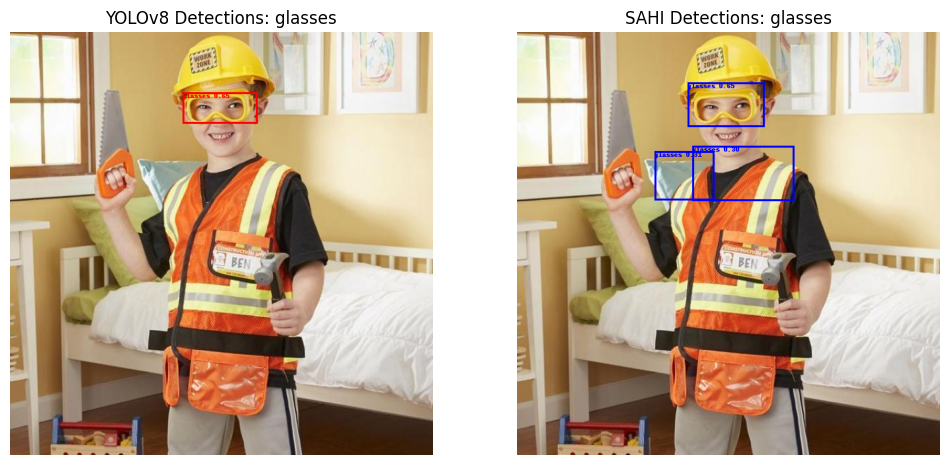


image 1/1 /content/combined_dataset/test/images/ILIo3t3wC45gUXfC9pKQIpXKAYxo_jpg.rf.ac9e755a562fe4f2a16a4e50ed08be11.jpg: 640x640 1 earphones, 198.7ms
Speed: 3.9ms preprocess, 198.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected earphones with confidence 0.26368457078933716
SAHI Detected earphones with confidence 0.26368457078933716


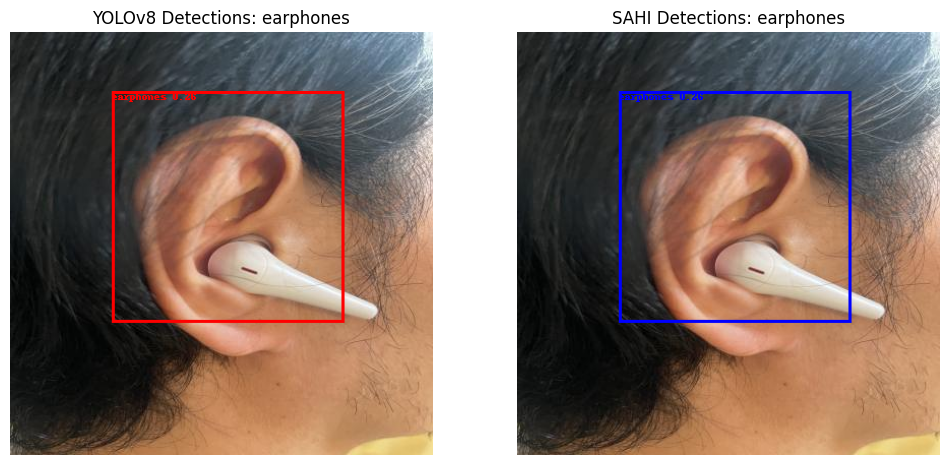


image 1/1 /content/combined_dataset/test/images/B01KSL9PEC_image3_jpg.rf.f7a66bd465ef8eeb41b5e870aa826cc6.jpg: 640x640 (no detections), 222.1ms
Speed: 7.1ms preprocess, 222.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
SAHI Detected glasses with confidence 0.31405875086784363


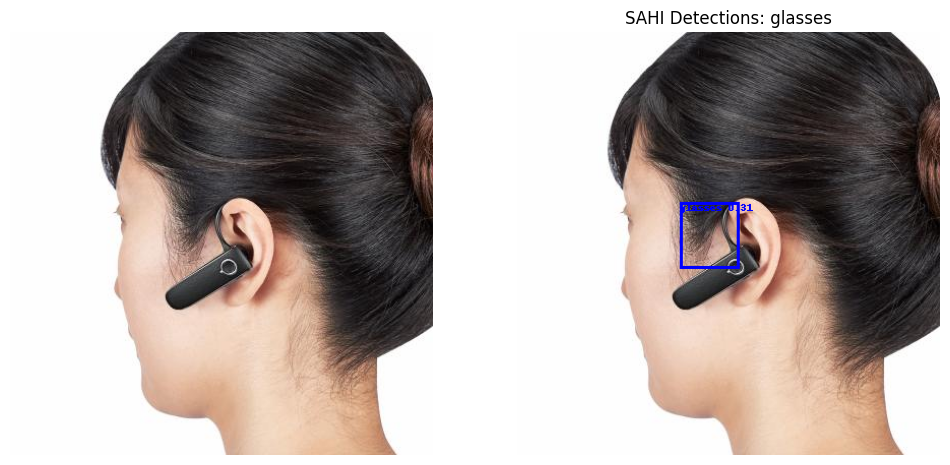


image 1/1 /content/combined_dataset/test/images/istockphoto-1264334837-612x612_jpg.rf.591d4417488dbfd2cb1dc7ddc6dd1230.jpg: 640x640 2 glassess, 236.5ms
Speed: 2.5ms preprocess, 236.5ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.8083322644233704
YOLOv8 Detected glasses with confidence 0.8035122156143188
SAHI Detected glasses with confidence 0.8083322644233704
SAHI Detected glasses with confidence 0.8035122156143188
SAHI Detected glasses with confidence 0.5937122106552124


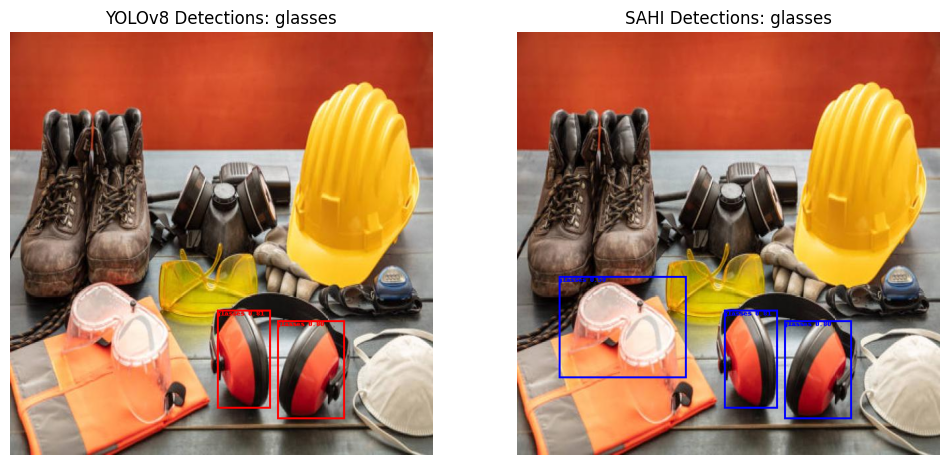


image 1/1 /content/combined_dataset/test/images/53_jpg.rf.bff32487597c009629c5395a4d131b07.jpg: 640x640 (no detections), 235.6ms
Speed: 5.1ms preprocess, 235.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.


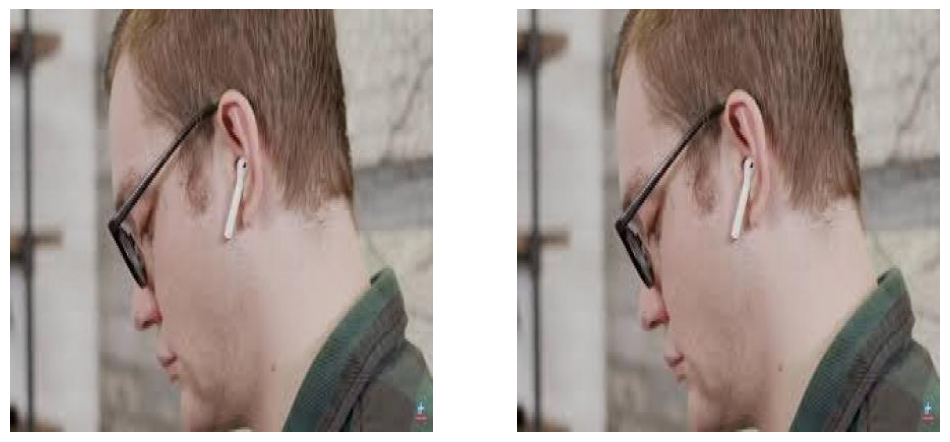


image 1/1 /content/combined_dataset/test/images/0_1--157-_jpg.rf.ee875495a6089afb8e0f6dc2916b63bf.jpg: 640x640 (no detections), 220.5ms
Speed: 3.9ms preprocess, 220.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.


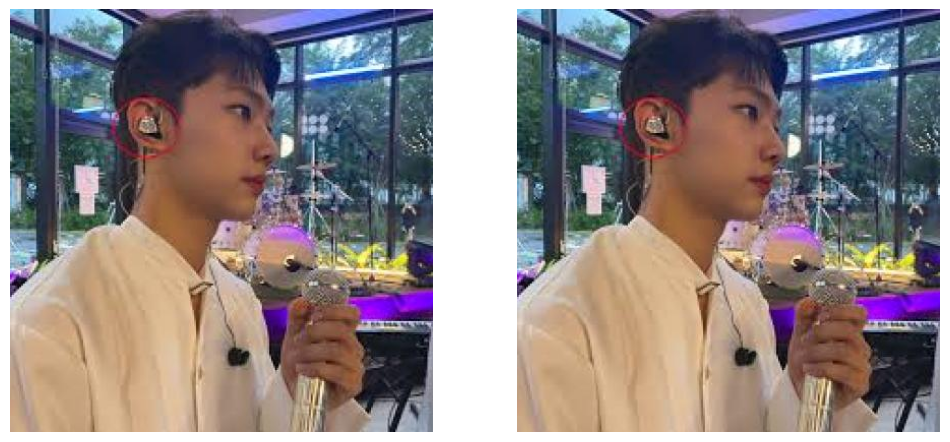


image 1/1 /content/combined_dataset/test/images/istockphoto-903523730-612x612_jpg.rf.c87f41d98f70e340279cd9dbea1f0407.jpg: 640x640 1 glasses, 201.4ms
Speed: 2.6ms preprocess, 201.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.5429056882858276
SAHI Detected glasses with confidence 0.5429056882858276
SAHI Detected glasses with confidence 0.2616177499294281


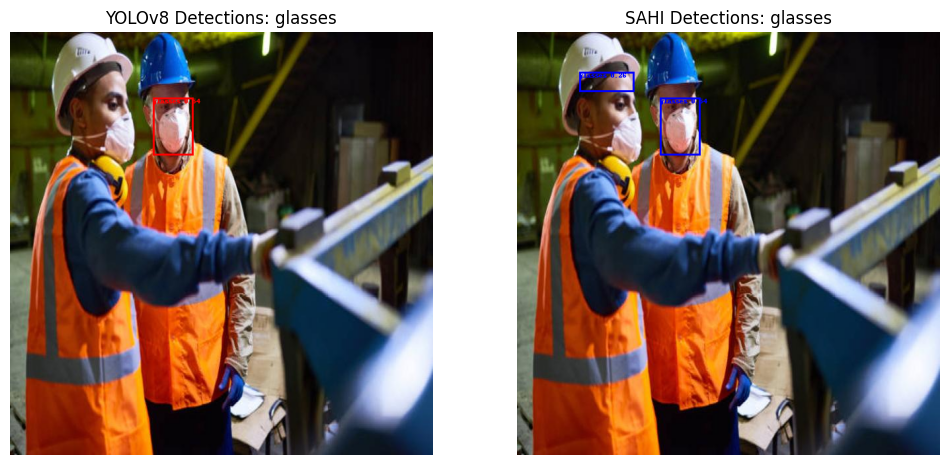


image 1/1 /content/combined_dataset/test/images/IMG_3175_jpeg.rf.f71463e83e1fd24789aad63975aa6c5d.jpg: 640x640 2 glassess, 213.3ms
Speed: 2.5ms preprocess, 213.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.9189084768295288
YOLOv8 Detected glasses with confidence 0.7354063987731934
SAHI Detected glasses with confidence 0.9189084768295288
SAHI Detected glasses with confidence 0.7354063987731934
SAHI Detected glasses with confidence 0.5450263023376465
SAHI Detected glasses with confidence 0.5182850956916809


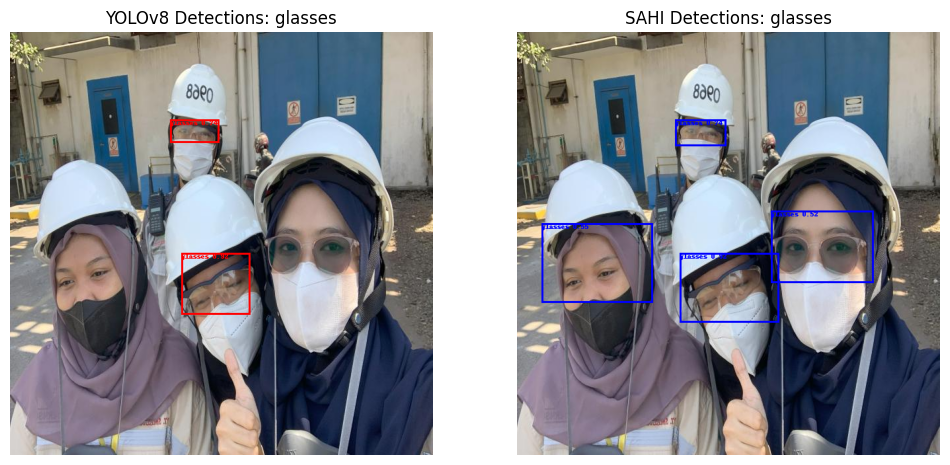


image 1/1 /content/combined_dataset/test/images/istockphoto-149319933-612x612_jpg.rf.90e39c7d1e1a7bc6be333a6ee3f865c8.jpg: 640x640 2 glassess, 215.0ms
Speed: 2.5ms preprocess, 215.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.8642076849937439
YOLOv8 Detected glasses with confidence 0.4912378191947937
SAHI Detected glasses with confidence 0.8642076849937439
SAHI Detected glasses with confidence 0.4912378191947937
SAHI Detected glasses with confidence 0.295542448759079


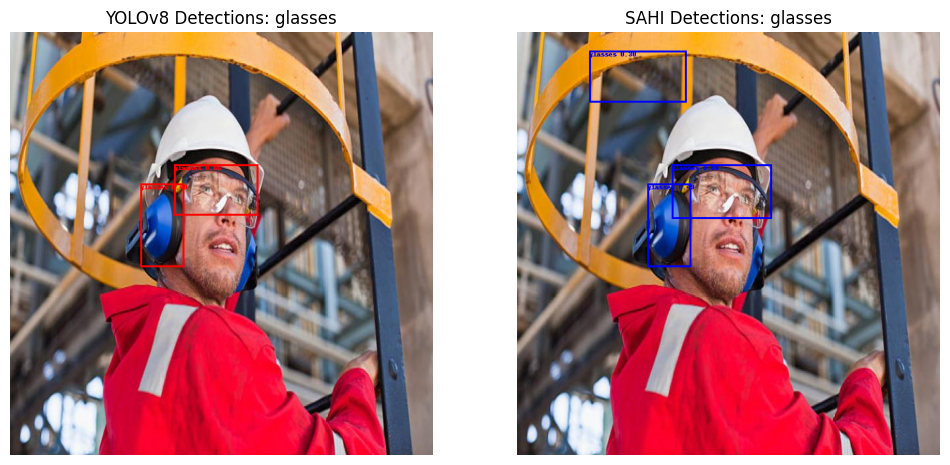


image 1/1 /content/combined_dataset/test/images/68-20191114130507_arxwtewp_jpg.rf.2953683d832bef1e7024c250770e21dd.jpg: 640x640 1 glasses, 238.1ms
Speed: 5.3ms preprocess, 238.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected glasses with confidence 0.2509508728981018
SAHI Detected glasses with confidence 0.5837180018424988


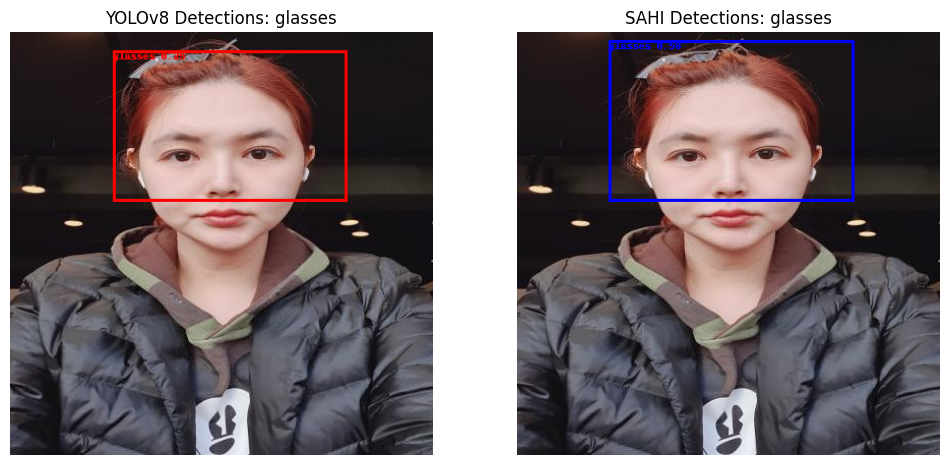


image 1/1 /content/combined_dataset/test/images/0_2--3-_jpg.rf.13a35738eb6d9d6a140f9acd282c0b15.jpg: 640x640 1 earphones, 214.1ms
Speed: 5.8ms preprocess, 214.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected earphones with confidence 0.2687673568725586
SAHI Detected earphones with confidence 0.2687673568725586


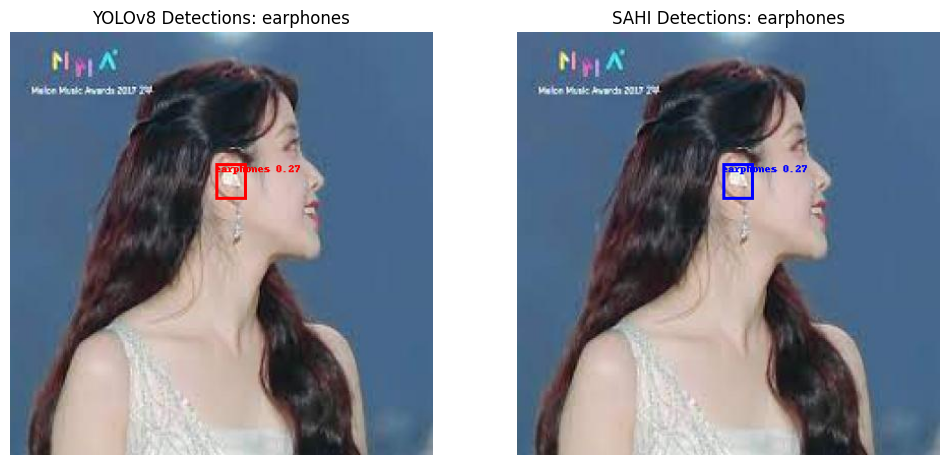


image 1/1 /content/combined_dataset/test/images/133_jpg.rf.6ae070fc755ad7cea4f266a1c46b4f01.jpg: 640x640 (no detections), 188.7ms
Speed: 4.1ms preprocess, 188.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
SAHI Detected glasses with confidence 0.420243501663208


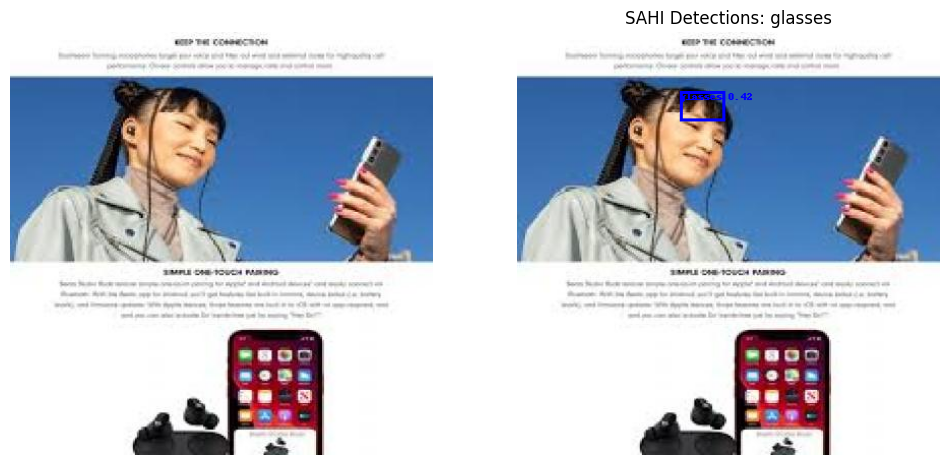


image 1/1 /content/combined_dataset/test/images/KakaoTalk_20220912_100901249_09_jpg.rf.16f218ea4c175ee91db7f934dc953ef1.jpg: 640x640 (no detections), 183.5ms
Speed: 4.2ms preprocess, 183.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
SAHI Detected glasses with confidence 0.2807624340057373
SAHI Detected glasses with confidence 0.27239295840263367


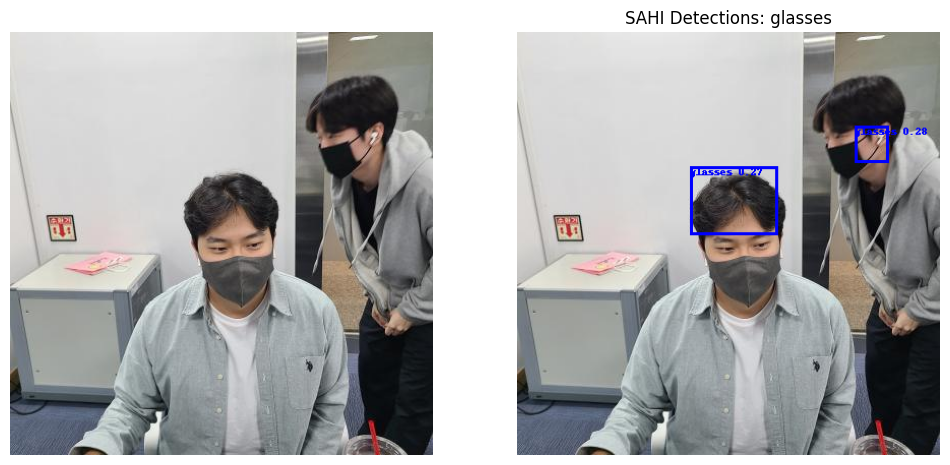


image 1/1 /content/combined_dataset/test/images/137_jpg.rf.e7ce703b5e05432031eef64e32aec8af.jpg: 640x640 1 glasses, 227.4ms
Speed: 4.0ms preprocess, 227.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected glasses with confidence 0.4394840896129608
SAHI Detected glasses with confidence 0.4394840896129608


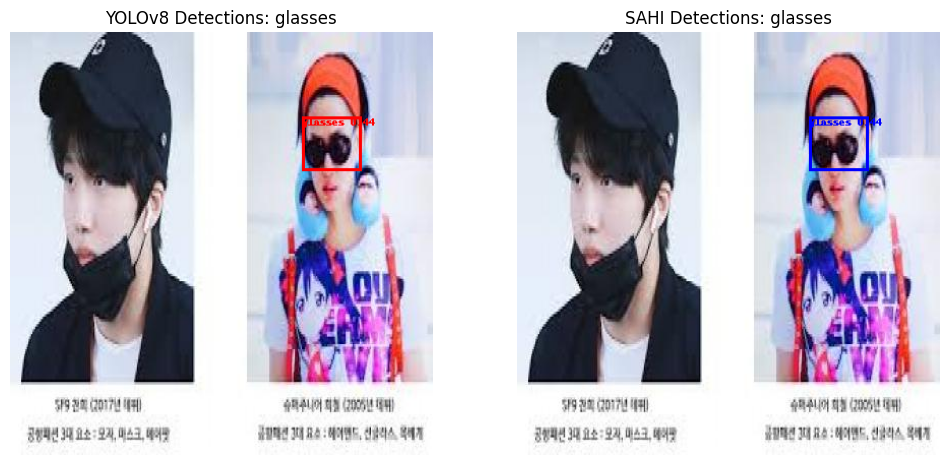


image 1/1 /content/combined_dataset/test/images/cb832e3f02e7baea3af5d28b6d628590_jpg.rf.deb3defff3e8515e1e8c8afd15730187.jpg: 640x640 1 earphones, 201.0ms
Speed: 4.2ms preprocess, 201.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected earphones with confidence 0.5774411559104919
SAHI Detected earphones with confidence 0.5774411559104919
SAHI Detected glasses with confidence 0.5046592950820923


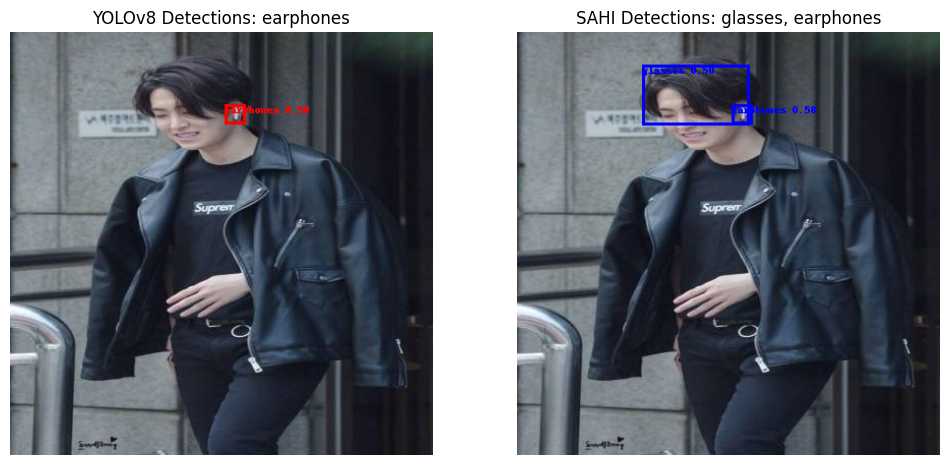


image 1/1 /content/combined_dataset/test/images/0003297115_004_20191129180201579_jpg.rf.a6e47290c7b3acb66e238f5cf4cda3c4.jpg: 640x640 (no detections), 222.4ms
Speed: 4.3ms preprocess, 222.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.


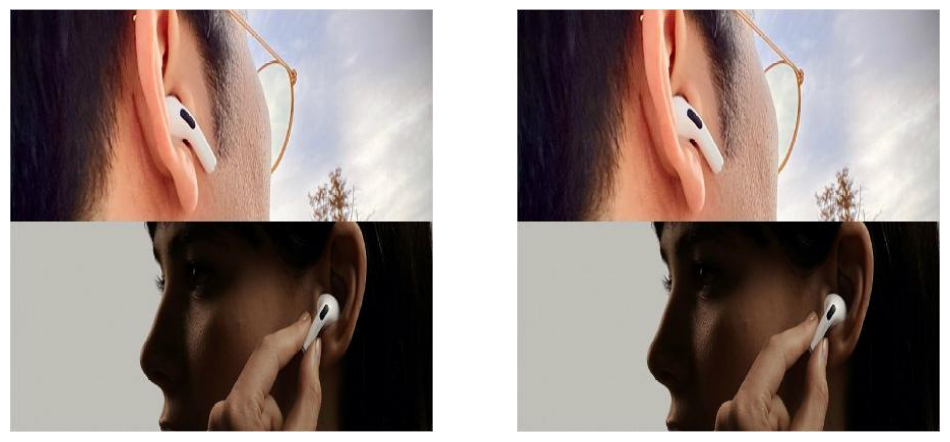


image 1/1 /content/combined_dataset/test/images/105_JPG_jpg.rf.f34863af152532ad66612fcfb1090737.jpg: 640x640 1 glasses, 203.6ms
Speed: 2.4ms preprocess, 203.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.7325092554092407
SAHI Detected glasses with confidence 0.7325092554092407


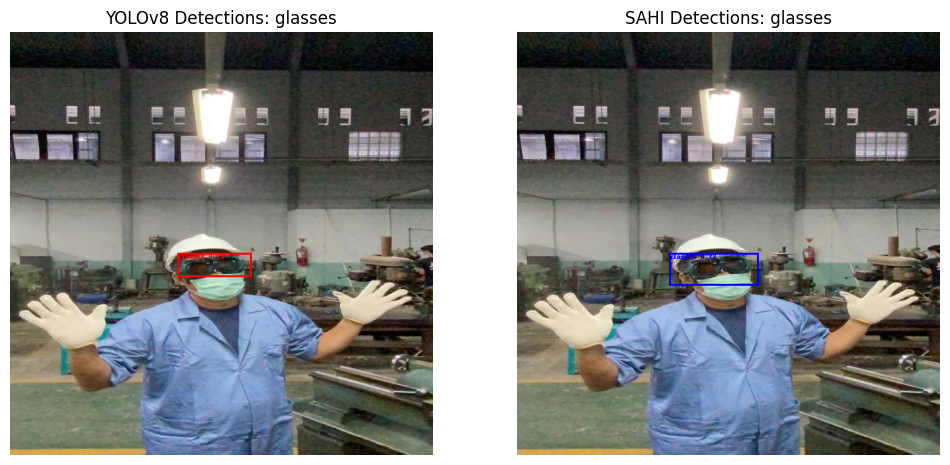


image 1/1 /content/combined_dataset/test/images/Video1_216_jpg.rf.6dcf8b3d075cb196b31894b154044207.jpg: 640x640 2 glassess, 246.1ms
Speed: 2.4ms preprocess, 246.1ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.6097136735916138
YOLOv8 Detected glasses with confidence 0.5008900165557861
SAHI Detected glasses with confidence 0.6097136735916138


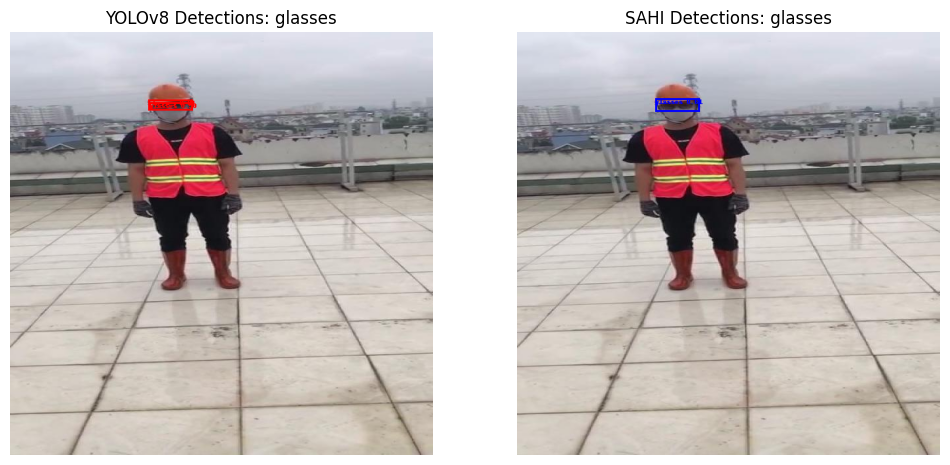


image 1/1 /content/combined_dataset/test/images/69_jpg.rf.d3a3cc365a0e045fccffe885f0830209.jpg: 640x640 1 earphones, 208.0ms
Speed: 3.8ms preprocess, 208.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected earphones with confidence 0.30634623765945435
SAHI Detected earphones with confidence 0.30634623765945435


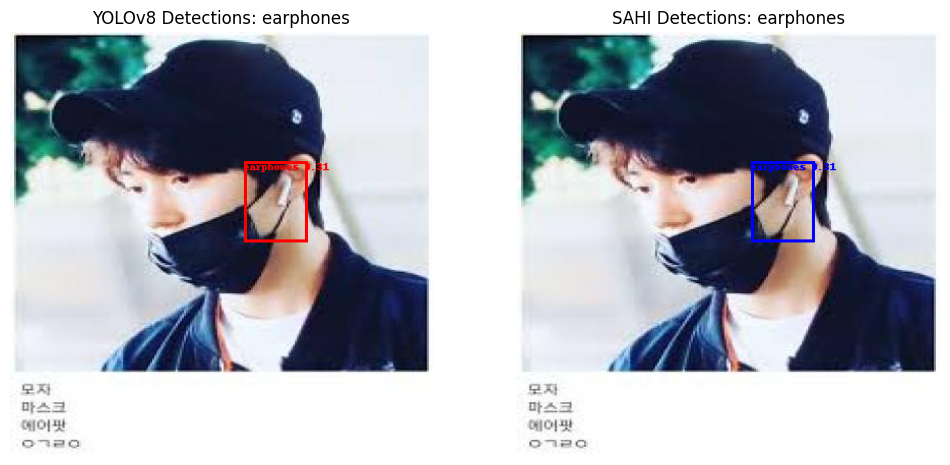


image 1/1 /content/combined_dataset/test/images/istockphoto-1358222838-612x612_jpg.rf.34805ba1778dafc6cd1726e7e6de5cc6.jpg: 640x640 2 glassess, 235.7ms
Speed: 2.4ms preprocess, 235.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.4866045415401459
YOLOv8 Detected glasses with confidence 0.37909966707229614
SAHI Detected glasses with confidence 0.4866045415401459
SAHI Detected glasses with confidence 0.41473329067230225


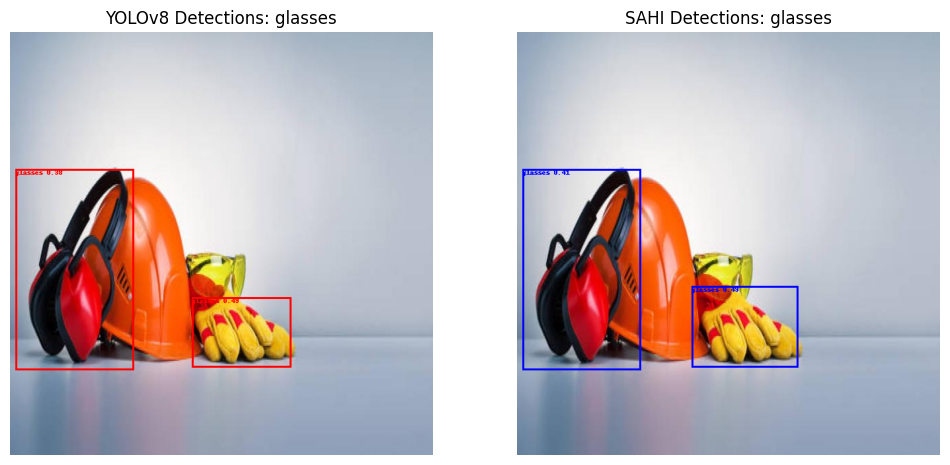


image 1/1 /content/combined_dataset/test/images/istockphoto-1338031471-612x612_jpg.rf.25244bb4cded2d94349800306c6eb5d8.jpg: 640x640 2 glassess, 208.9ms
Speed: 2.5ms preprocess, 208.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.6949355006217957
YOLOv8 Detected glasses with confidence 0.5294809937477112
SAHI Detected glasses with confidence 0.6949355006217957
SAHI Detected glasses with confidence 0.5294809937477112


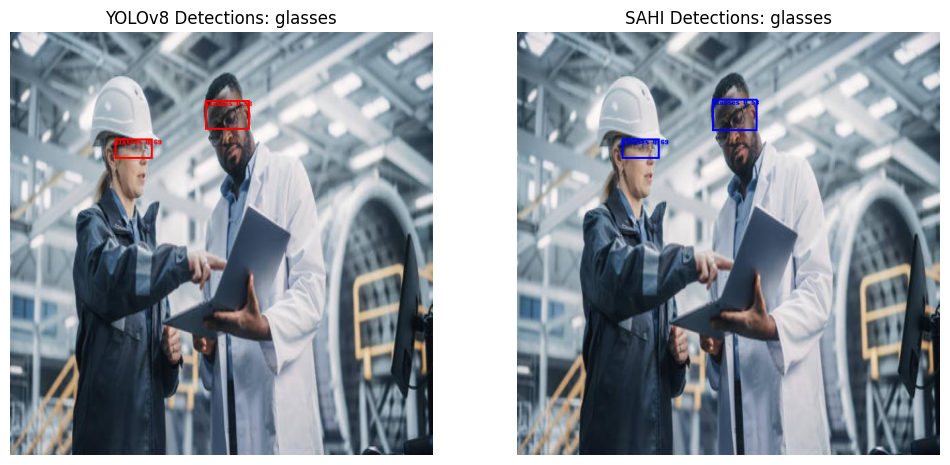


image 1/1 /content/combined_dataset/test/images/IMG_2945_jpeg.rf.c1463a9f2a1f718f92eb007acae265dd.jpg: 640x640 1 glasses, 749.0ms
Speed: 2.4ms preprocess, 749.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.8244135975837708
SAHI Detected glasses with confidence 0.8244135975837708
SAHI Detected glasses with confidence 0.6108452677726746
SAHI Detected glasses with confidence 0.46266332268714905
SAHI Detected glasses with confidence 0.42420628666877747


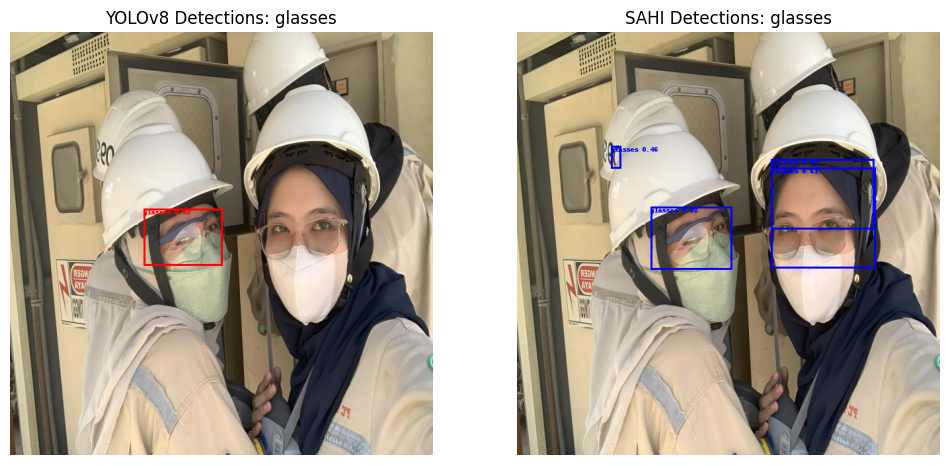


image 1/1 /content/combined_dataset/test/images/istockphoto-537388732-612x612_jpg.rf.560ba5b6493d758b5c7f4695f1c36e84.jpg: 640x640 3 glassess, 203.6ms
Speed: 2.4ms preprocess, 203.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.8411698937416077
YOLOv8 Detected glasses with confidence 0.8073803782463074
YOLOv8 Detected glasses with confidence 0.5401595830917358
SAHI Detected glasses with confidence 0.8974884152412415
SAHI Detected glasses with confidence 0.8547478318214417
SAHI Detected glasses with confidence 0.6739727854728699
SAHI Detected glasses with confidence 0.5652416944503784
SAHI Detected glasses with confidence 0.292526513338089
SAHI Detected glasses with confidence 0.2599959671497345


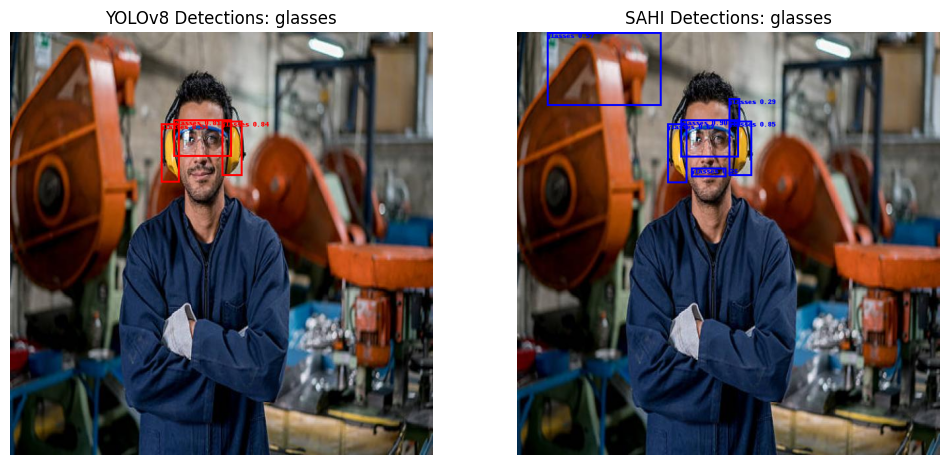


image 1/1 /content/combined_dataset/test/images/istockphoto-157590003-612x612_jpg.rf.baf8162bfd046e764ae603346b8ea25c.jpg: 640x640 2 glassess, 216.2ms
Speed: 2.5ms preprocess, 216.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.7472904920578003
YOLOv8 Detected glasses with confidence 0.4551871120929718
SAHI Detected earphones with confidence 0.4035376012325287
SAHI Detected glasses with confidence 0.7472904920578003
SAHI Detected glasses with confidence 0.4551871120929718
SAHI Detected glasses with confidence 0.43908536434173584
SAHI Detected glasses with confidence 0.29806649684906006


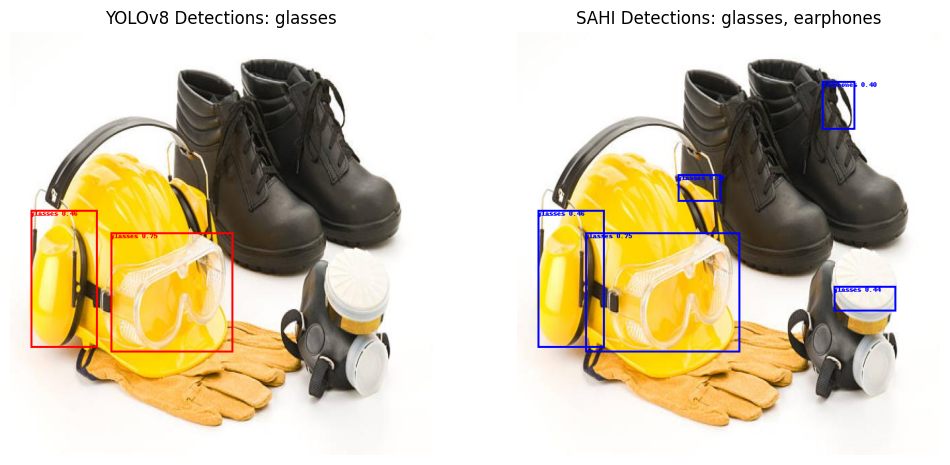


image 1/1 /content/combined_dataset/test/images/160_jpg.rf.46a13eac4cf7cc1d58b3f0167c9e2c69.jpg: 640x640 (no detections), 238.5ms
Speed: 6.1ms preprocess, 238.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.


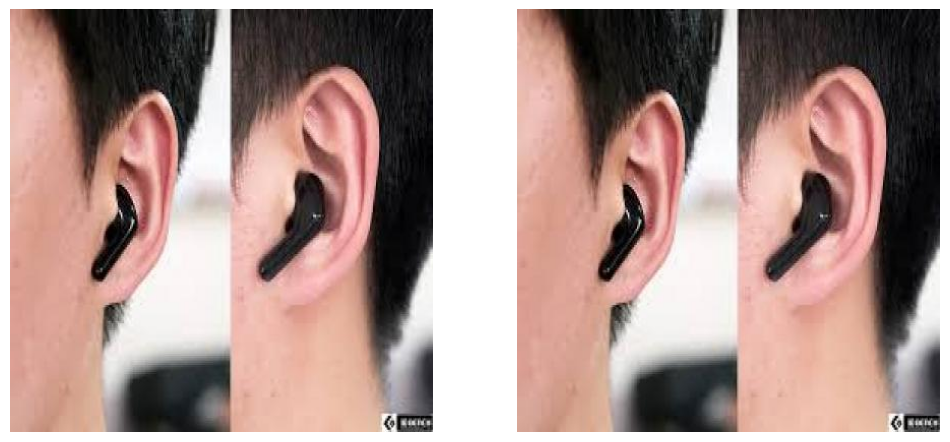


image 1/1 /content/combined_dataset/test/images/istockphoto-1290396328-612x612-1-_jpg.rf.565e69894f8878b5f8494fefd6a28e34.jpg: 640x640 2 glassess, 248.7ms
Speed: 5.7ms preprocess, 248.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.7958823442459106
YOLOv8 Detected glasses with confidence 0.6041423678398132
SAHI Detected glasses with confidence 0.7958823442459106
SAHI Detected glasses with confidence 0.6041423678398132


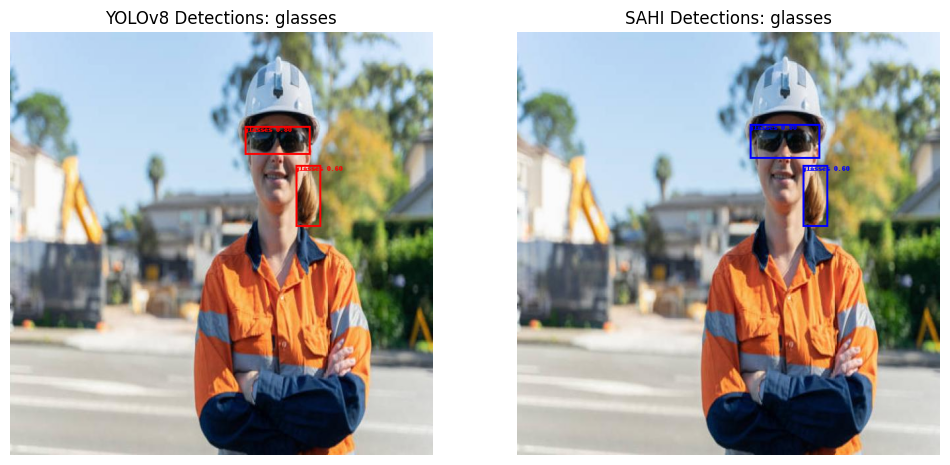


image 1/1 /content/combined_dataset/test/images/I5NlDMVglJCsj6DvQTbBPkAm-QeI_jpg.rf.1a4dfd507f450f8eeb54bad7ef7df932.jpg: 640x640 (no detections), 232.9ms
Speed: 5.4ms preprocess, 232.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
SAHI Detected glasses with confidence 0.7774999141693115
SAHI Detected glasses with confidence 0.5876246094703674


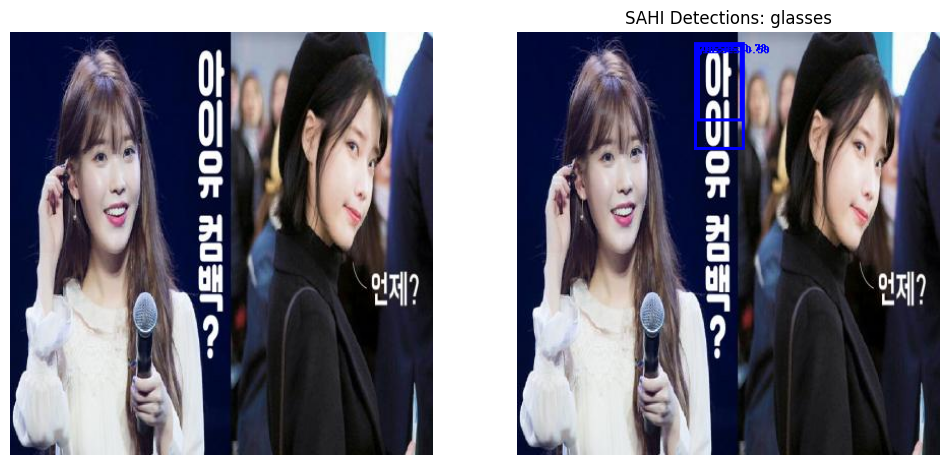


image 1/1 /content/combined_dataset/test/images/0_2--79-_jpg.rf.0121d76a3b8a4452f82d99a704115174.jpg: 640x640 (no detections), 190.4ms
Speed: 4.4ms preprocess, 190.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
SAHI Detected glasses with confidence 0.2847731113433838


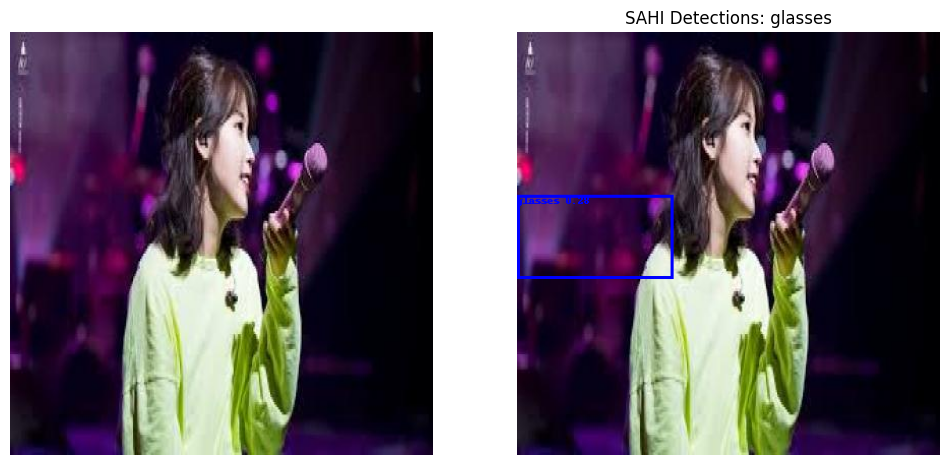


image 1/1 /content/combined_dataset/test/images/istockphoto-1292772544-612x612_jpg.rf.54e8bc1cc646dd90d90b944e830b775b.jpg: 640x640 1 glasses, 194.6ms
Speed: 2.5ms preprocess, 194.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.8337064385414124
SAHI Detected glasses with confidence 0.8337064385414124


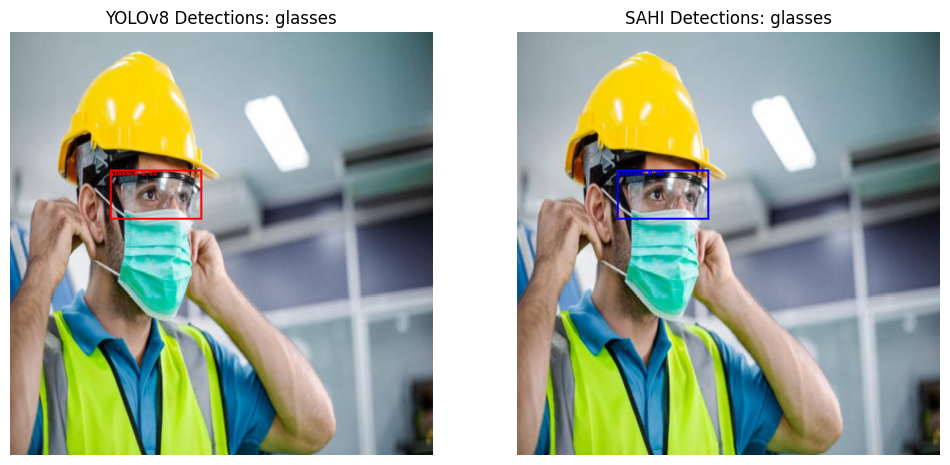


image 1/1 /content/combined_dataset/test/images/73_jpg.rf.65d315ed1658d27781d49b62cf13d07c.jpg: 640x640 1 glasses, 197.0ms
Speed: 4.6ms preprocess, 197.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected glasses with confidence 0.5286639928817749
SAHI Detected glasses with confidence 0.5286639928817749


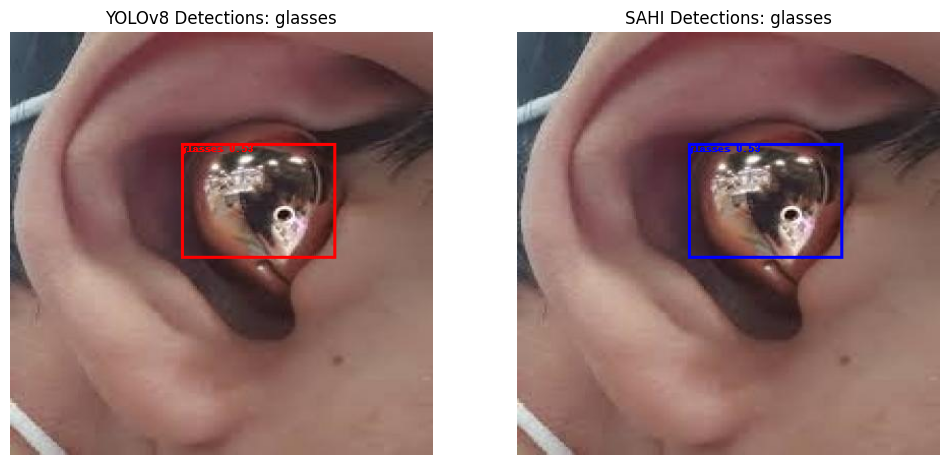


image 1/1 /content/combined_dataset/test/images/72_jpg.rf.6a47305caccf93ff695766f535c6c461.jpg: 640x640 2 glassess, 184.9ms
Speed: 3.9ms preprocess, 184.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected glasses with confidence 0.6235789060592651
YOLOv8 Detected glasses with confidence 0.4383696913719177
SAHI Detected glasses with confidence 0.6235789060592651
SAHI Detected glasses with confidence 0.6180672645568848


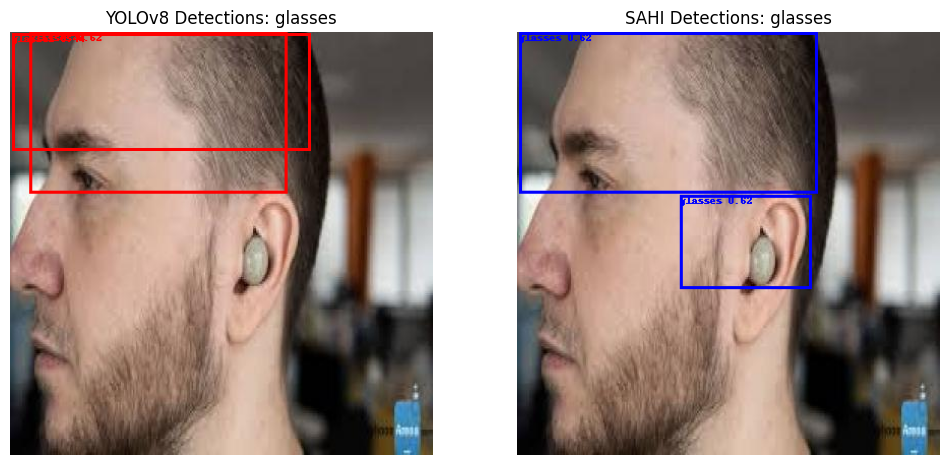


image 1/1 /content/combined_dataset/test/images/147_jpg.rf.2d6f1fd9518c919027da96bb4dd3e776.jpg: 640x640 2 glassess, 182.6ms
Speed: 3.8ms preprocess, 182.6ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected glasses with confidence 0.32523950934410095
YOLOv8 Detected glasses with confidence 0.2782391905784607
SAHI Detected glasses with confidence 0.603463888168335
SAHI Detected glasses with confidence 0.2782391905784607


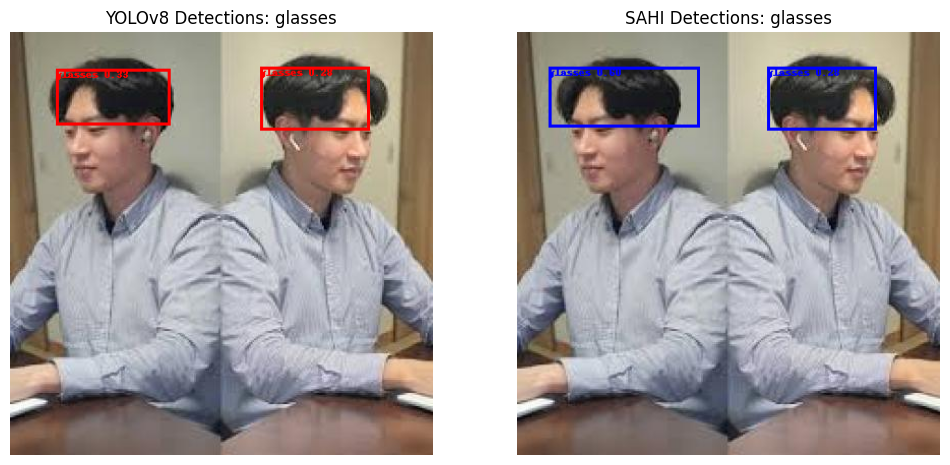


image 1/1 /content/combined_dataset/test/images/134_jpg.rf.4aaa038a669606b2b8dc2c1a137b6be2.jpg: 640x640 1 earphones, 230.0ms
Speed: 3.7ms preprocess, 230.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected earphones with confidence 0.5969167351722717
SAHI Detected earphones with confidence 0.5969167351722717


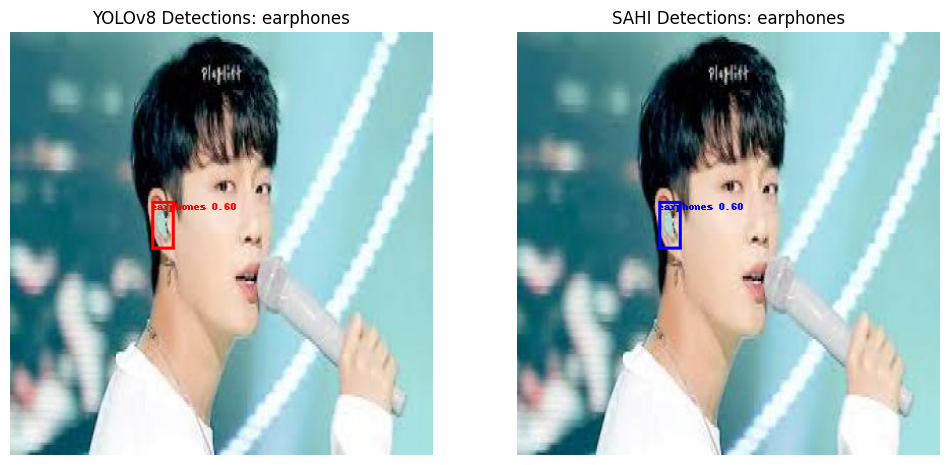


image 1/1 /content/combined_dataset/test/images/0_1--4-_jpg.rf.4978c1e0c89a6567e10a06a749dc7239.jpg: 640x640 (no detections), 210.6ms
Speed: 4.4ms preprocess, 210.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.


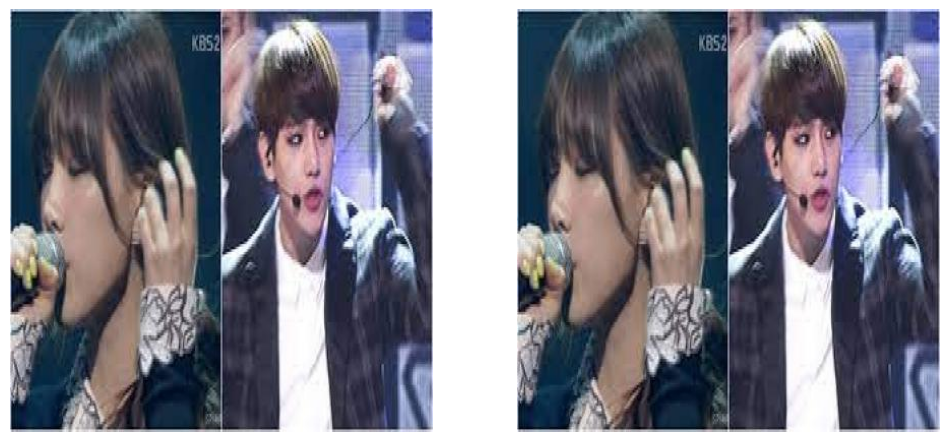


image 1/1 /content/combined_dataset/test/images/125_jpg.rf.856c5b3f943736c7110bce1187966049.jpg: 640x640 (no detections), 218.8ms
Speed: 3.7ms preprocess, 218.8ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.


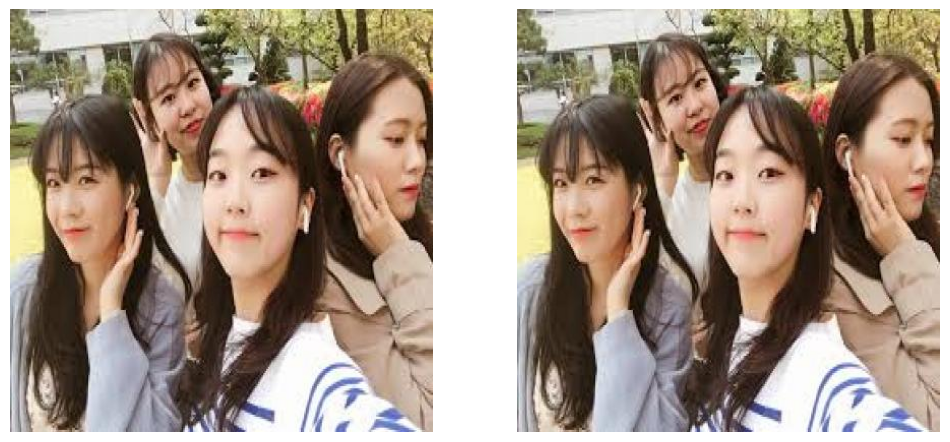


image 1/1 /content/combined_dataset/test/images/istockphoto-552721633-612x612_jpg.rf.16520b7d1d15150383562ed6ee769383.jpg: 640x640 3 glassess, 198.7ms
Speed: 2.4ms preprocess, 198.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.7429814338684082
YOLOv8 Detected glasses with confidence 0.689297080039978
YOLOv8 Detected glasses with confidence 0.6671002507209778
SAHI Detected glasses with confidence 0.7429814338684082
SAHI Detected glasses with confidence 0.689297080039978
SAHI Detected glasses with confidence 0.6671002507209778
SAHI Detected glasses with confidence 0.2610088884830475


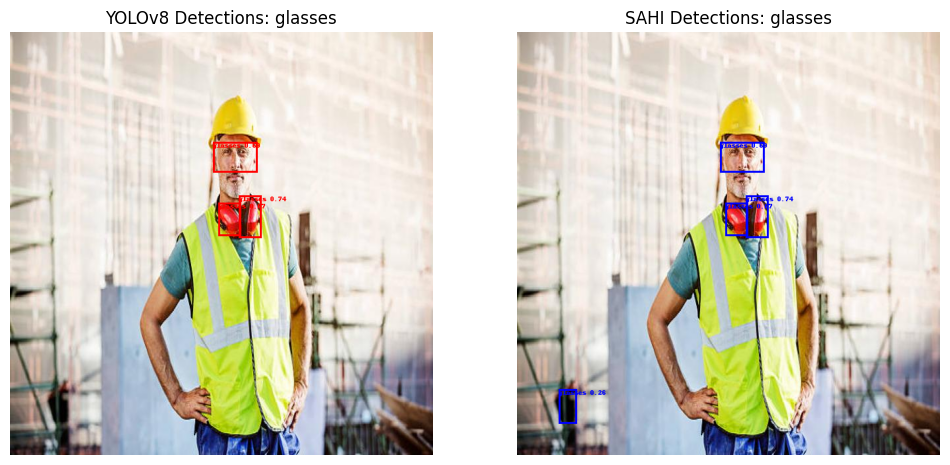


image 1/1 /content/combined_dataset/test/images/maxresdefault-1-_jpg.rf.1f49635e344309745ec418d5cb8616af.jpg: 640x640 3 glassess, 207.6ms
Speed: 2.7ms preprocess, 207.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.7598015069961548
YOLOv8 Detected glasses with confidence 0.6195306181907654
YOLOv8 Detected glasses with confidence 0.6026064157485962
SAHI Detected glasses with confidence 0.8662939667701721
SAHI Detected glasses with confidence 0.8498039841651917
SAHI Detected glasses with confidence 0.7390321493148804


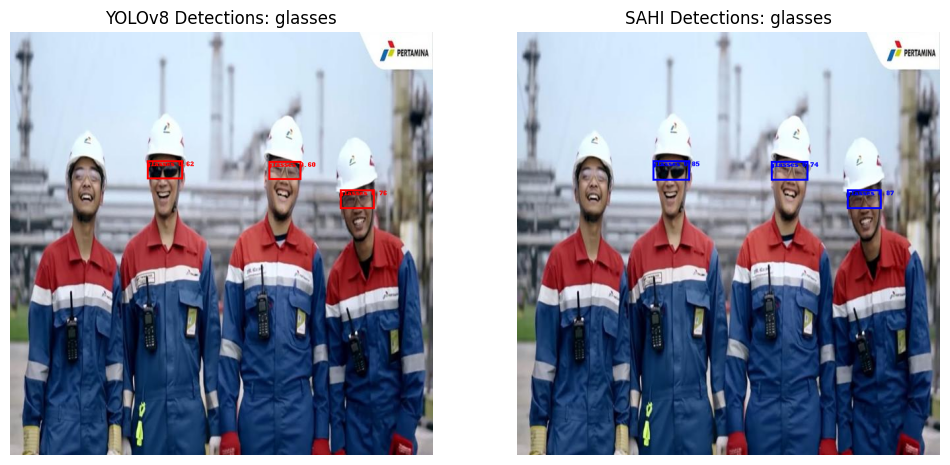


image 1/1 /content/combined_dataset/test/images/0001066724_001_20191029085348780_jpg.rf.71befe34c211f78be5fd4a3230df8753.jpg: 640x640 (no detections), 179.7ms
Speed: 4.0ms preprocess, 179.7ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
SAHI Detected glasses with confidence 0.46018531918525696
SAHI Detected glasses with confidence 0.4236989915370941


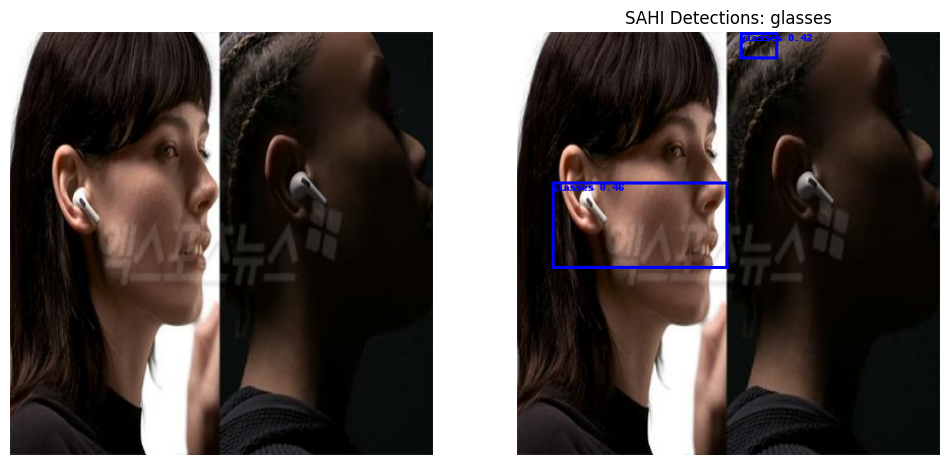


image 1/1 /content/combined_dataset/test/images/4_jpg.rf.1b477d60f1292c9b1d3faf0683ccd96d.jpg: 640x640 1 earphones, 199.8ms
Speed: 4.0ms preprocess, 199.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected earphones with confidence 0.6553058624267578
SAHI Detected earphones with confidence 0.6553058624267578


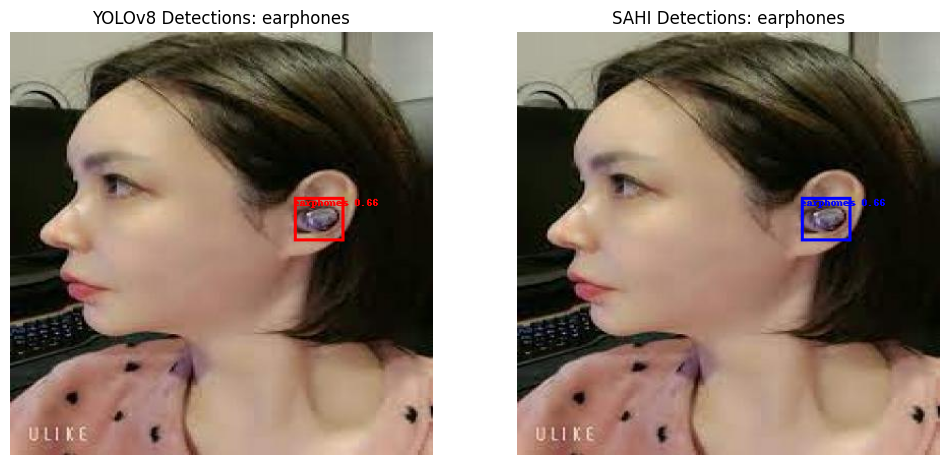


image 1/1 /content/combined_dataset/test/images/istockphoto-595329316-612x612_jpg.rf.b55177225cd82d8cb224cde22d37a4b0.jpg: 640x640 3 glassess, 188.3ms
Speed: 2.4ms preprocess, 188.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.9183693528175354
YOLOv8 Detected glasses with confidence 0.7846357226371765
YOLOv8 Detected glasses with confidence 0.5899221301078796
SAHI Detected glasses with confidence 0.9183693528175354
SAHI Detected glasses with confidence 0.8284333944320679
SAHI Detected glasses with confidence 0.8058859705924988
SAHI Detected glasses with confidence 0.6214285492897034


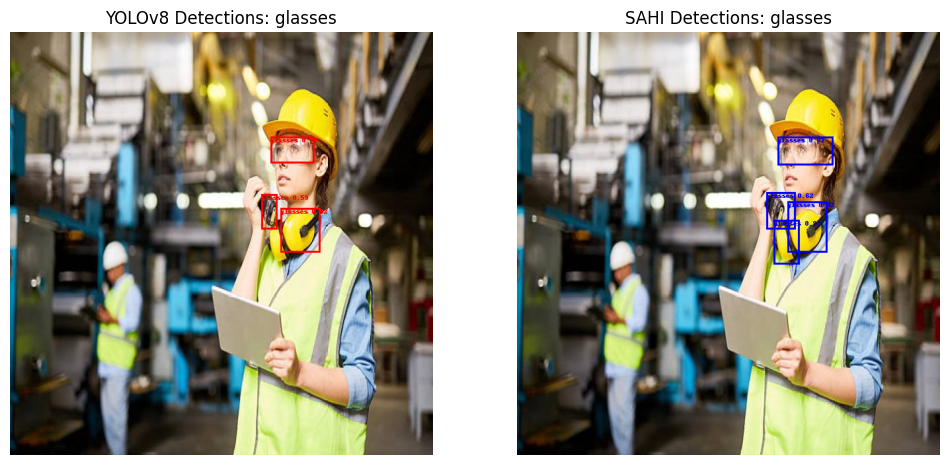


image 1/1 /content/combined_dataset/test/images/129_jpg.rf.d44d1f1fe22284dc58007de6b06b5411.jpg: 640x640 (no detections), 235.2ms
Speed: 3.8ms preprocess, 235.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.


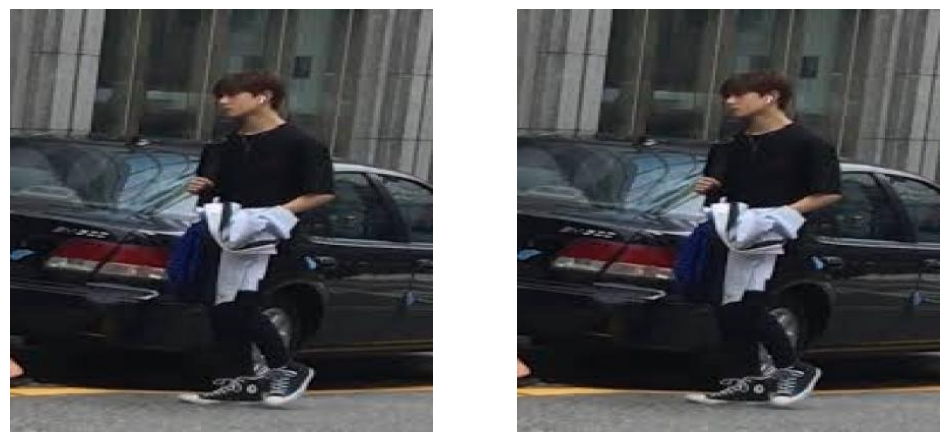


image 1/1 /content/combined_dataset/test/images/136_jpg.rf.4f62f3120adba859871253fe799d07e3.jpg: 640x640 (no detections), 193.8ms
Speed: 3.9ms preprocess, 193.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.


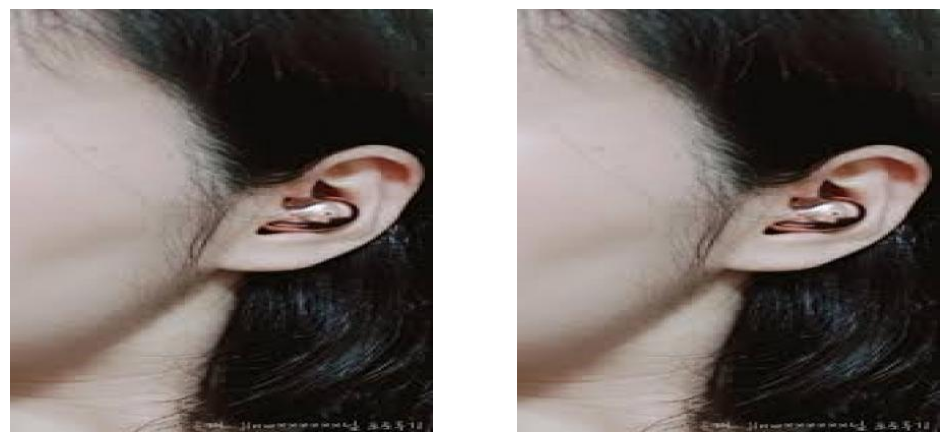


image 1/1 /content/combined_dataset/test/images/image_179_jpg.rf.6576b71f248d4db5058cc3d3c921f426.jpg: 640x640 1 glasses, 201.0ms
Speed: 3.1ms preprocess, 201.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.7283550500869751
SAHI Detected glasses with confidence 0.7283550500869751


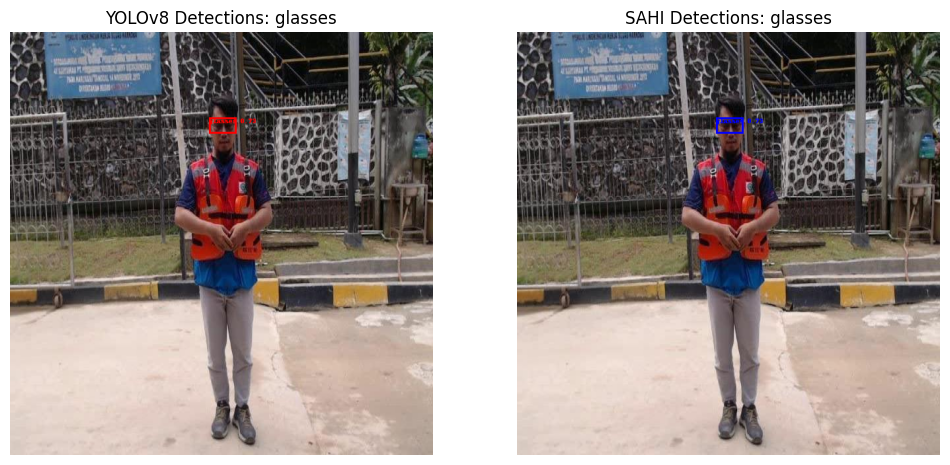


image 1/1 /content/combined_dataset/test/images/477f24ce4f8676c7b9a3c71e45b2f7ba_jpg.rf.24b08925f919ff686db4a92a2eee3b12.jpg: 640x640 3 earphoness, 183.2ms
Speed: 3.7ms preprocess, 183.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected earphones with confidence 0.4225083589553833
YOLOv8 Detected earphones with confidence 0.38233524560928345
YOLOv8 Detected earphones with confidence 0.28275734186172485
SAHI Detected earphones with confidence 0.4225083589553833
SAHI Detected earphones with confidence 0.38233524560928345
SAHI Detected earphones with confidence 0.28046199679374695


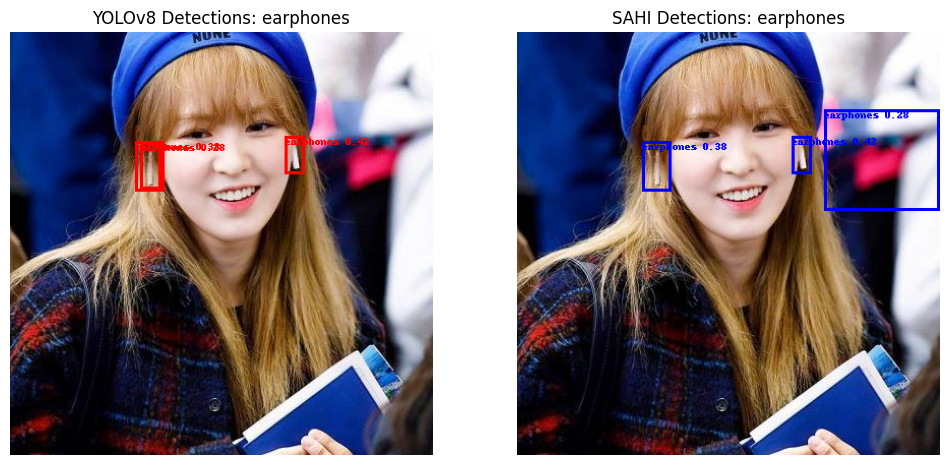


image 1/1 /content/combined_dataset/test/images/Video4_241_jpg.rf.9f1eecdbe10d2984e5c829f1229c9f82.jpg: 640x640 1 glasses, 197.3ms
Speed: 2.9ms preprocess, 197.3ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.6238391399383545
SAHI Detected earphones with confidence 0.4183984696865082
SAHI Detected glasses with confidence 0.6238391399383545


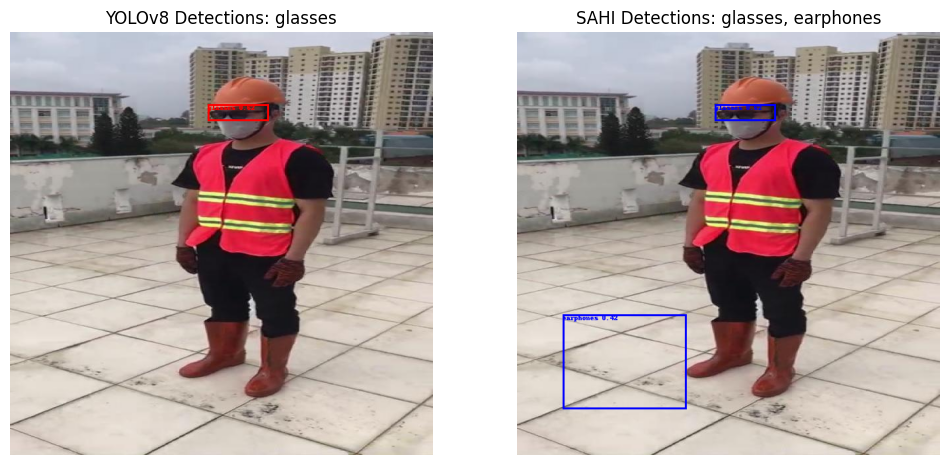


image 1/1 /content/combined_dataset/test/images/0_1--18-_jpg.rf.c157b3de52560e2cc3755b54272f3983.jpg: 640x640 1 earphones, 210.3ms
Speed: 9.0ms preprocess, 210.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected earphones with confidence 0.6902665495872498
SAHI Detected earphones with confidence 0.6902665495872498
SAHI Detected glasses with confidence 0.3821554183959961
SAHI Detected glasses with confidence 0.323861688375473
SAHI Detected glasses with confidence 0.2701479196548462


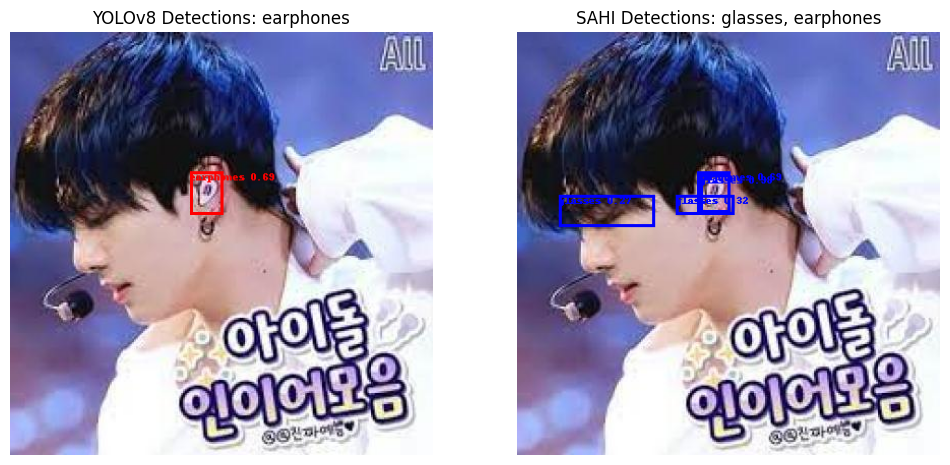


image 1/1 /content/combined_dataset/test/images/I0a7QRCOAwXiG1qJd3dwPfpcv_dw_jpg.rf.743d6cc7ddfcc6f2250ef0b3f8fea50d.jpg: 640x640 1 earphones, 193.9ms
Speed: 4.2ms preprocess, 193.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected earphones with confidence 0.6696454882621765
SAHI Detected earphones with confidence 0.6696454882621765


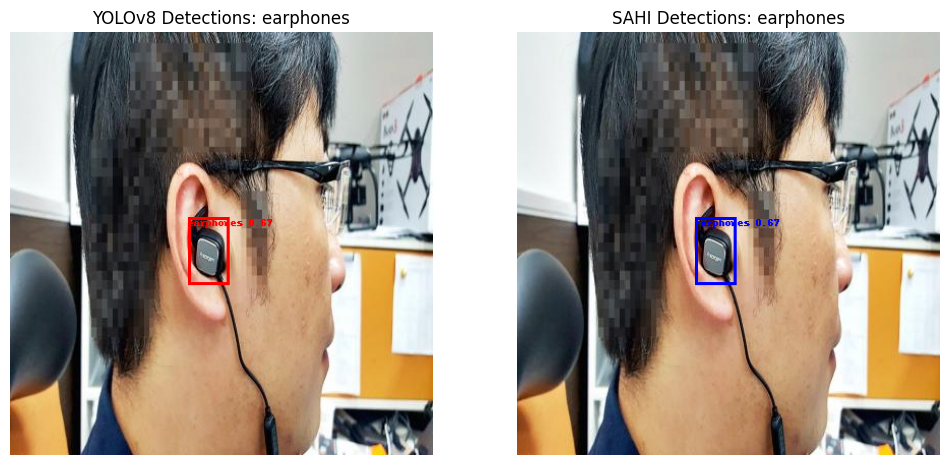


image 1/1 /content/combined_dataset/test/images/istockphoto-165829163-612x612_jpg.rf.8d151a809811255a7561e9cf96428fe9.jpg: 640x640 2 glassess, 203.2ms
Speed: 2.7ms preprocess, 203.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 9 slices.
YOLOv8 Detected glasses with confidence 0.7270689606666565
YOLOv8 Detected glasses with confidence 0.388071745634079
SAHI Detected glasses with confidence 0.7270689606666565
SAHI Detected glasses with confidence 0.26740771532058716


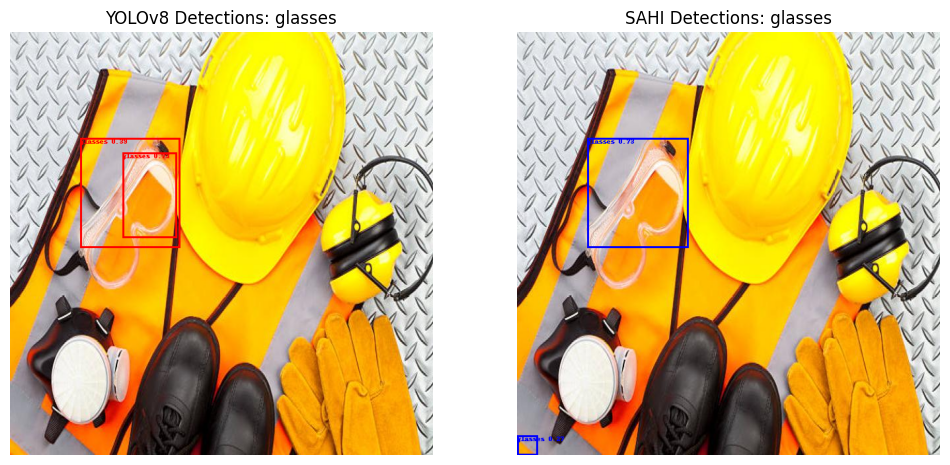


image 1/1 /content/combined_dataset/test/images/KakaoTalk_20220912_100901249_17_jpg.rf.0f5c215ef77120d10645a1a38d3837a0.jpg: 640x640 1 earphones, 1 glasses, 545.0ms
Speed: 14.0ms preprocess, 545.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected earphones with confidence 0.6725823283195496
YOLOv8 Detected glasses with confidence 0.39568910002708435
SAHI Detected earphones with confidence 0.7721385955810547
SAHI Detected glasses with confidence 0.4554930627346039


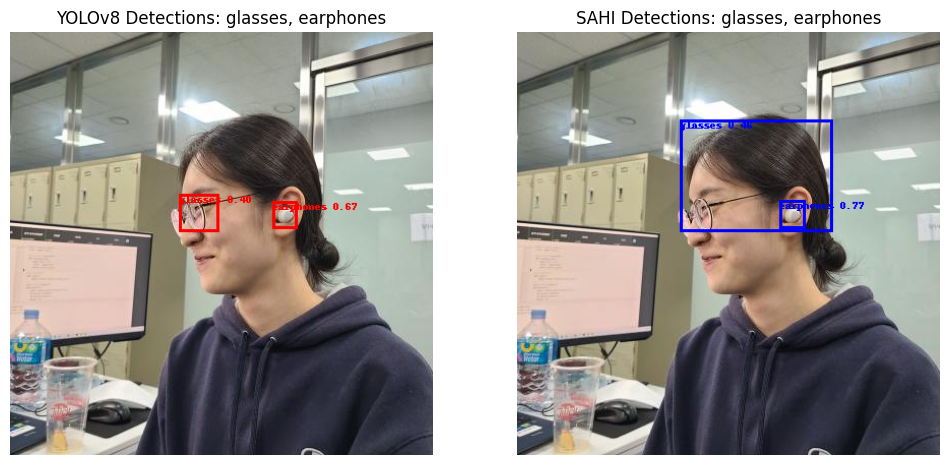


image 1/1 /content/combined_dataset/test/images/d9c4efed655e1e2c57a95e88ef4392a3_jpg.rf.a5ff307f917e58dced189f10d31bde2b.jpg: 640x640 1 earphones, 209.2ms
Speed: 4.2ms preprocess, 209.2ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected earphones with confidence 0.6918150186538696
SAHI Detected earphones with confidence 0.6918150186538696


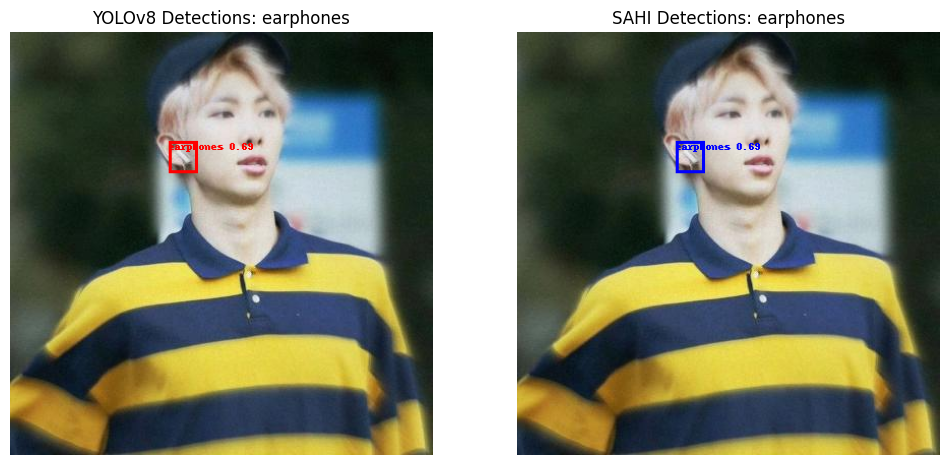


image 1/1 /content/combined_dataset/test/images/154_jpg.rf.c17dc877b8697d5e7aaac8007ccf7b9b.jpg: 640x640 1 glasses, 187.7ms
Speed: 4.2ms preprocess, 187.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected glasses with confidence 0.26671820878982544
SAHI Detected glasses with confidence 0.26671820878982544


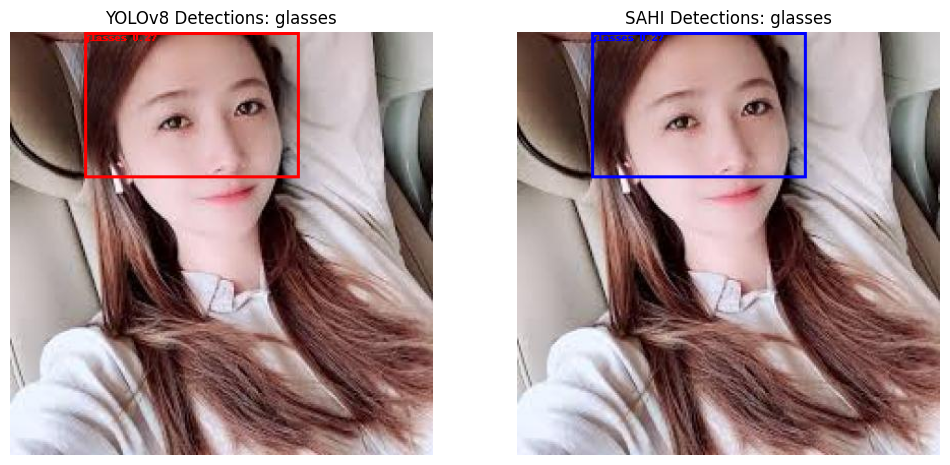


image 1/1 /content/combined_dataset/test/images/I5qVbshsV3hZN699C3wUyI9KHvD4_jpg.rf.d5281cb2cca6d80a0c58a2082eccfa2c.jpg: 640x640 1 earphones, 205.9ms
Speed: 4.0ms preprocess, 205.9ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)
Performing prediction on 4 slices.
YOLOv8 Detected earphones with confidence 0.2914559543132782
SAHI Detected earphones with confidence 0.2914559543132782


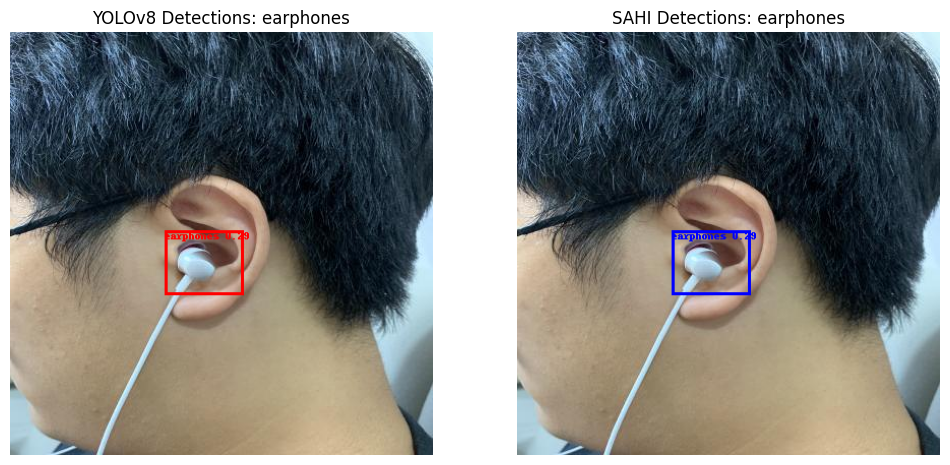

                                                Image   YOLOv8 Detections  \
0      80_jpg.rf.0de078add86ba81b77238f6e3018ac6d.jpg           earphones   
1   gettyimages-1036354066-612x612_jpg.rf.48e643fd...             glasses   
2     135_jpg.rf.10e626998c826b9218fd6fe3da5d5543.jpg             glasses   
3      32_jpg.rf.8f9d49f315157531897b9a5dac7186eb.jpg                None   
4   0_2--42-_jpg.rf.b044294461b5920a060a36640ef90e...                None   
..                                                ...                 ...   
64  istockphoto-165829163-612x612_jpg.rf.8d151a809...             glasses   
65  KakaoTalk_20220912_100901249_17_jpg.rf.0f5c215...  glasses, earphones   
66  d9c4efed655e1e2c57a95e88ef4392a3_jpg.rf.a5ff30...           earphones   
67    154_jpg.rf.c17dc877b8697d5e7aaac8007ccf7b9b.jpg             glasses   
68  I5qVbshsV3hZN699C3wUyI9KHvD4_jpg.rf.d5281cb2cc...           earphones   

       SAHI Detections  
0            earphones  
1              glasses  


In [ ]:
import os
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
from torchvision.transforms.functional import to_pil_image
import numpy as np
import pandas as pd
from ultralytics import YOLO
from sahi import AutoDetectionModel
from sahi.predict import get_sliced_prediction

folder_path = '/content/combined_dataset/test/images'

if not os.path.exists(folder_path):
    raise FileNotFoundError(f"The folder path '{folder_path}' does not exist.")


yolo_model_path = '/content/runs/detect/train/weights/best.pt'
yolo_model = YOLO(yolo_model_path)


sahi_model = AutoDetectionModel.from_pretrained(
    model_type='yolov8',
    model_path=yolo_model_path,
    confidence_threshold=0.25,
    device='cpu')


display_confidence_threshold = 0.25
comparison_results = []#results list


for filename in os.listdir(folder_path):
    if filename.endswith(".jpg") or filename.endswith(".png"):
        img_path = os.path.join(folder_path, filename)


        yolo_results = yolo_model.predict(img_path) #yolov8 pred

        # SAHI pred
        sahi_results = get_sliced_prediction(
            img_path,
            sahi_model,
            slice_height=256,
            slice_width=256,
            overlap_height_ratio=0.2,
            overlap_width_ratio=0.2
        )


        img = Image.open(img_path)

        # YOLOv8 results
        yolo_annotated_img = img.copy()
        yolo_draw = ImageDraw.Draw(yolo_annotated_img)
        yolo_detected_classes = set()

        for result in yolo_results:
            for box in result.boxes:
                class_id = int(box.cls)
                class_name = result.names[class_id]
                confidence = box.conf.item()

                if confidence > display_confidence_threshold:
                    xmin, ymin, xmax, ymax = box.xyxy[0].tolist()
                    print(f"YOLOv8 Detected {class_name} with confidence {confidence}")


                    yolo_draw.rectangle([xmin, ymin, xmax, ymax], outline='red', width=3)
                    yolo_draw.text((xmin, ymin), f"{class_name} {confidence:.2f}", fill='red')
                    yolo_detected_classes.add(class_name)

        # SAHI results
        sahi_annotated_img = img.copy()
        sahi_draw = ImageDraw.Draw(sahi_annotated_img)
        sahi_detected_classes = set()

        for detection in sahi_results.object_prediction_list:
            class_name = detection.category.name
            confidence = detection.score.value

            if confidence > display_confidence_threshold:
                xmin, ymin, xmax, ymax = detection.bbox.to_xyxy()

                print(f"SAHI Detected {class_name} with confidence {confidence}")


                sahi_draw.rectangle([xmin, ymin, xmax, ymax], outline='blue', width=3)
                sahi_draw.text((xmin, ymin), f"{class_name} {confidence:.2f}", fill='blue')
                sahi_detected_classes.add(class_name)


        yolo_annotated_img_array = np.array(yolo_annotated_img)
        sahi_annotated_img_array = np.array(sahi_annotated_img)

       #diplay yolov8 image
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(to_pil_image(yolo_annotated_img_array))
        plt.axis('off')
        if yolo_detected_classes:
            plt.title(f"YOLOv8 Detections: {', '.join(yolo_detected_classes)}")

        #diplay sahi image
        plt.subplot(1, 2, 2)
        plt.imshow(to_pil_image(sahi_annotated_img_array))
        plt.axis('off')
        if sahi_detected_classes:
            plt.title(f"SAHI Detections: {', '.join(sahi_detected_classes)}")
        plt.show()

        #comparison on the basis of confidence score
        comparison_results.append({
            "Image": filename,
            "YOLOv8 Detections": ', '.join(yolo_detected_classes) if yolo_detected_classes else 'None',
            "SAHI Detections": ', '.join(sahi_detected_classes) if sahi_detected_classes else 'None'
        })
comparison_df = pd.DataFrame(comparison_results)
print(comparison_df)



0: 640x640 1 earphones, 8.3ms
Speed: 2.7ms preprocess, 8.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.8256892561912537


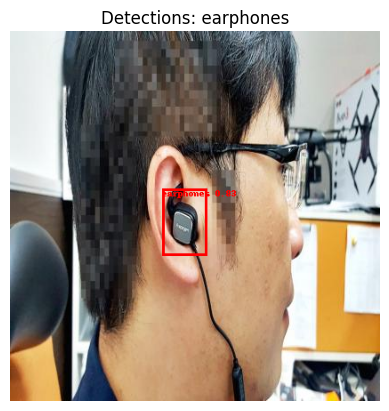


0: 640x640 1 earphones, 8.8ms
Speed: 3.5ms preprocess, 8.8ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.6884610652923584


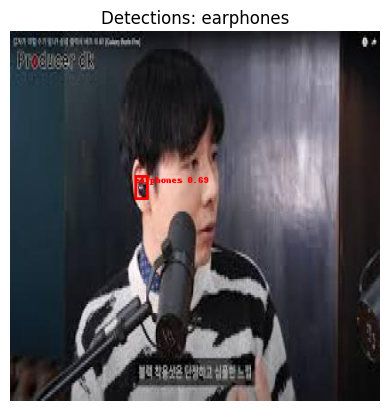


0: 640x640 (no detections), 7.6ms
Speed: 2.5ms preprocess, 7.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


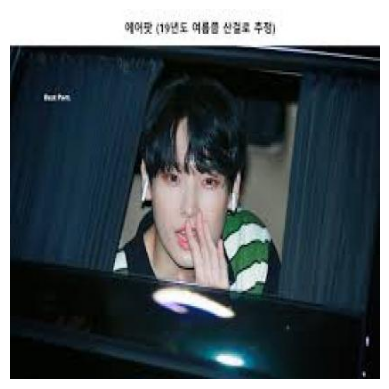


0: 640x640 1 earphones, 8.7ms
Speed: 3.3ms preprocess, 8.7ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.7161203622817993


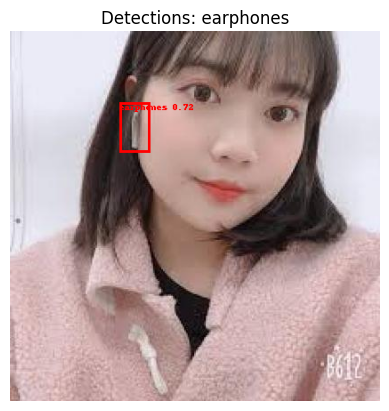


0: 640x640 1 earphones, 7.8ms
Speed: 3.4ms preprocess, 7.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.419390469789505


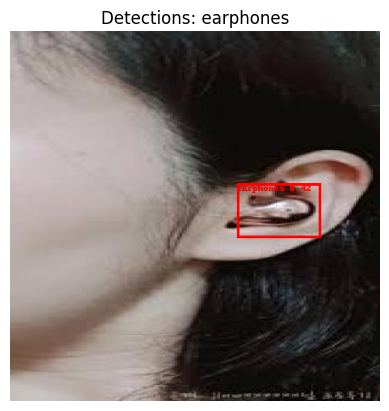


0: 640x640 (no detections), 9.4ms
Speed: 3.4ms preprocess, 9.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


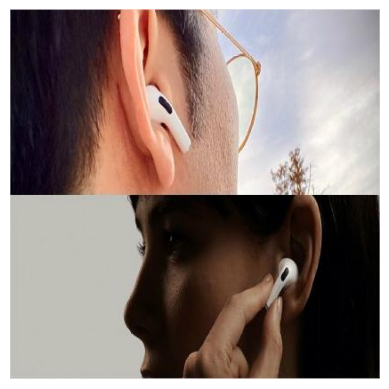


0: 640x640 2 earphoness, 7.5ms
Speed: 2.7ms preprocess, 7.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.7204481363296509
Detected earphones with confidence 0.7105757594108582


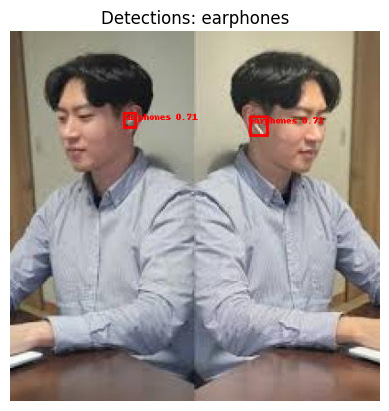


0: 640x640 (no detections), 7.7ms
Speed: 2.6ms preprocess, 7.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


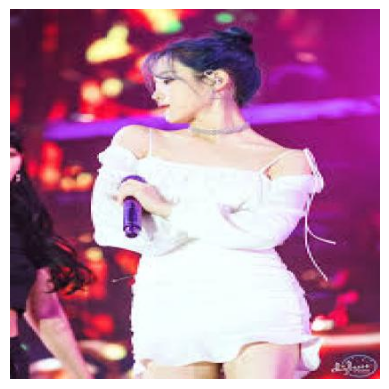


0: 640x640 1 earphones, 8.9ms
Speed: 3.1ms preprocess, 8.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.8014070987701416


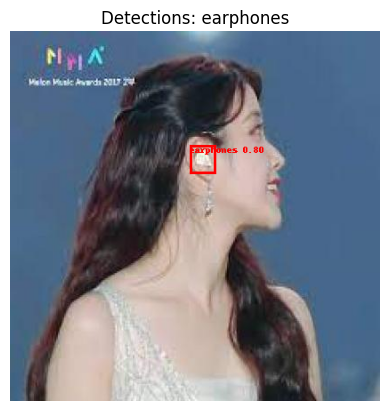


0: 640x640 2 earphoness, 10.0ms
Speed: 3.8ms preprocess, 10.0ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.8222543597221375
Detected earphones with confidence 0.28088077902793884


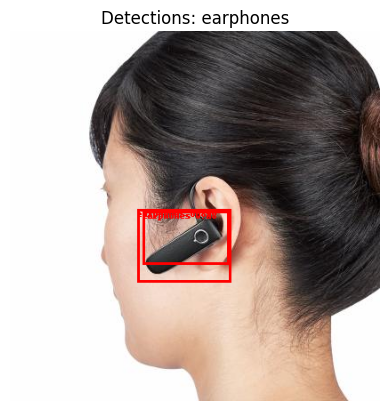


0: 640x640 2 earphoness, 7.4ms
Speed: 2.7ms preprocess, 7.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.6646929383277893
Detected earphones with confidence 0.2549287974834442


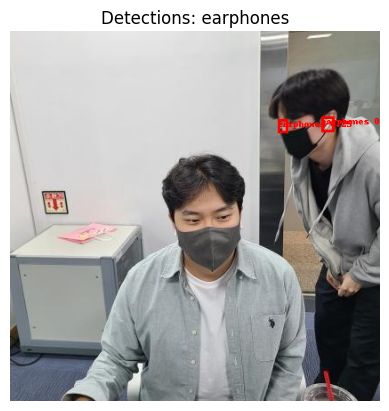


0: 640x640 (no detections), 7.6ms
Speed: 3.1ms preprocess, 7.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


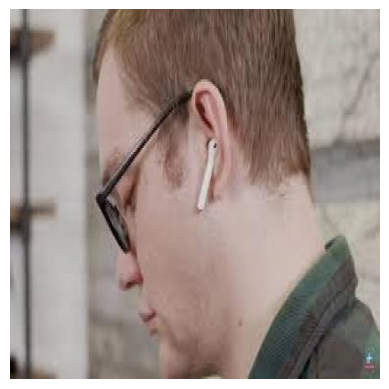


0: 640x640 (no detections), 9.1ms
Speed: 3.5ms preprocess, 9.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


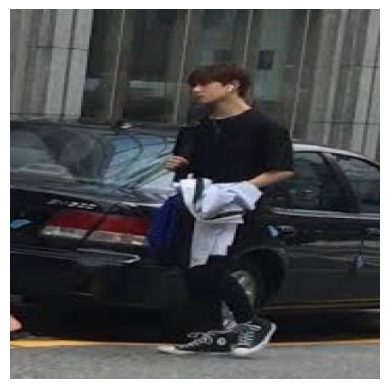


0: 640x640 2 earphoness, 7.4ms
Speed: 2.6ms preprocess, 7.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.7389817237854004
Detected earphones with confidence 0.6925970911979675


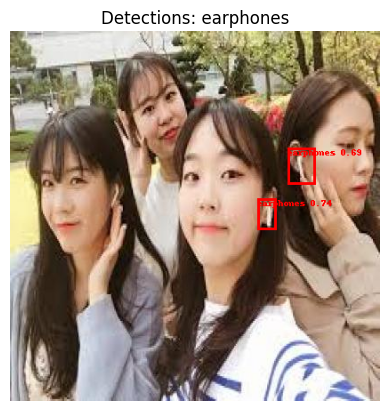


0: 640x640 1 earphones, 7.7ms
Speed: 2.7ms preprocess, 7.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.7050315737724304


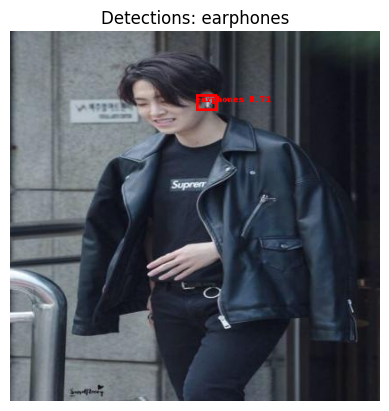


0: 640x640 (no detections), 9.0ms
Speed: 3.5ms preprocess, 9.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


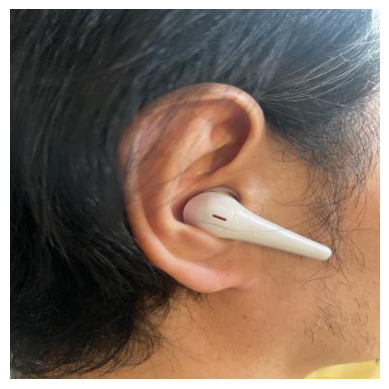


0: 640x640 1 earphones, 7.8ms
Speed: 3.8ms preprocess, 7.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.634865939617157


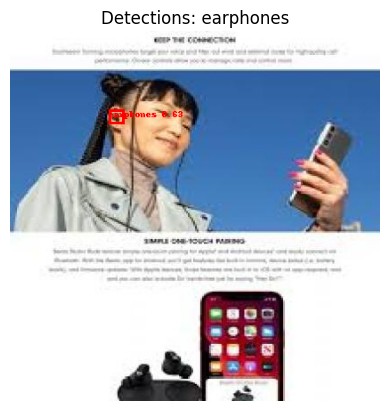


0: 640x640 3 earphoness, 7.4ms
Speed: 2.6ms preprocess, 7.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.7112159132957458
Detected earphones with confidence 0.5026726126670837
Detected earphones with confidence 0.36247143149375916


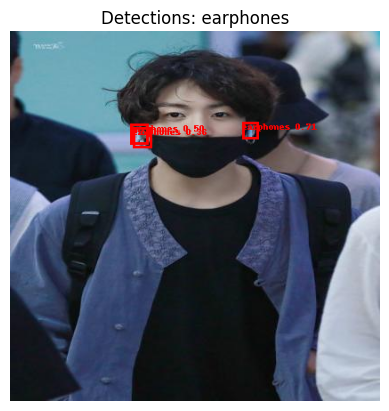


0: 640x640 (no detections), 7.8ms
Speed: 3.6ms preprocess, 7.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


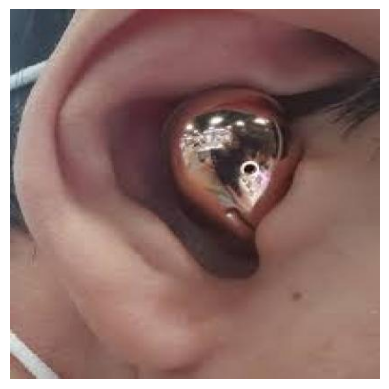


0: 640x640 (no detections), 9.2ms
Speed: 3.5ms preprocess, 9.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


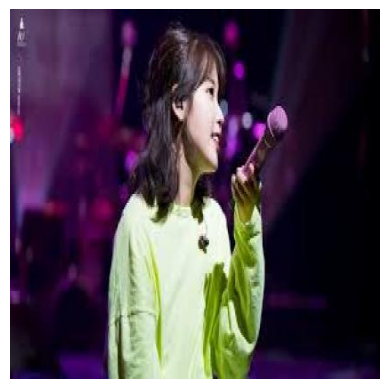


0: 640x640 (no detections), 7.5ms
Speed: 2.6ms preprocess, 7.5ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


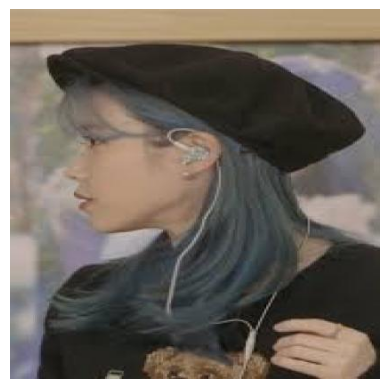


0: 640x640 2 earphoness, 9.2ms
Speed: 3.4ms preprocess, 9.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.6356691718101501
Detected earphones with confidence 0.5100246667861938


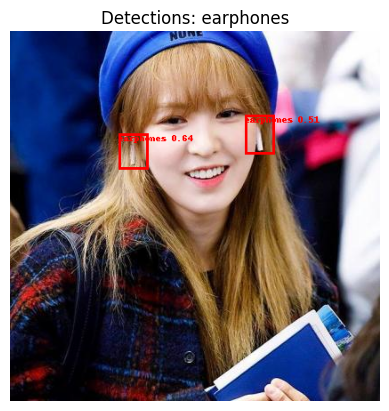


0: 640x640 (no detections), 7.5ms
Speed: 2.8ms preprocess, 7.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


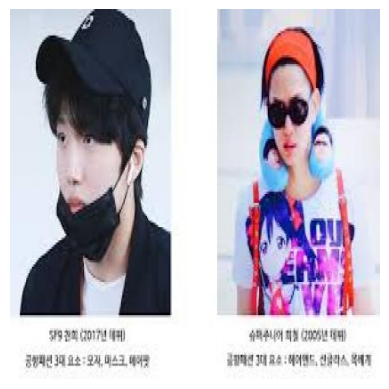


0: 640x640 1 earphones, 9.1ms
Speed: 3.4ms preprocess, 9.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.8105273842811584


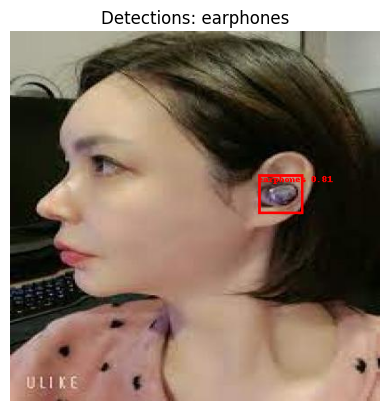


0: 640x640 1 earphones, 7.9ms
Speed: 2.4ms preprocess, 7.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.8212469220161438


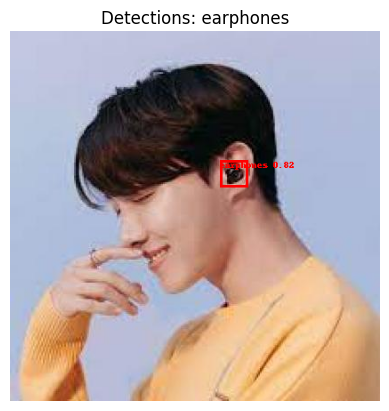


0: 640x640 1 earphones, 8.6ms
Speed: 3.4ms preprocess, 8.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.7992035150527954


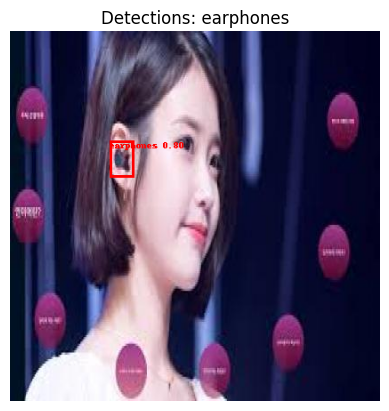


0: 640x640 1 earphones, 7.5ms
Speed: 2.6ms preprocess, 7.5ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.31508389115333557


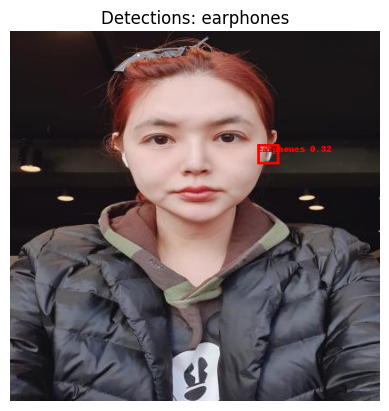


0: 640x640 1 earphones, 7.5ms
Speed: 2.7ms preprocess, 7.5ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.8069366812705994


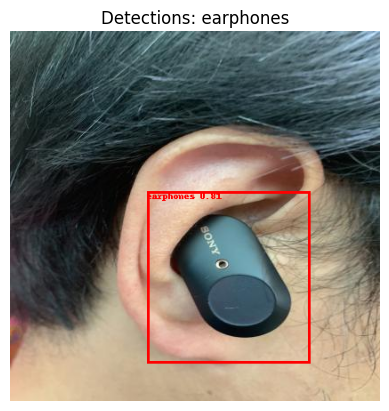


0: 640x640 1 earphones, 8.1ms
Speed: 2.6ms preprocess, 8.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.7737810611724854


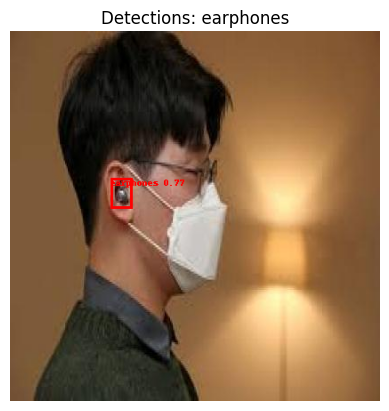


0: 640x640 1 earphones, 7.4ms
Speed: 2.5ms preprocess, 7.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.5201200246810913


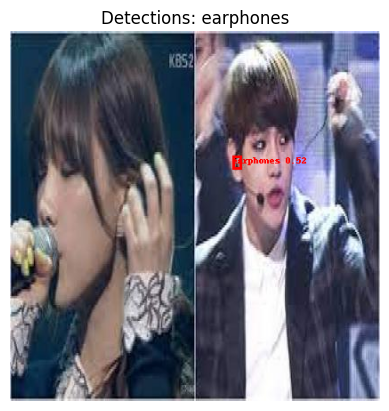


0: 640x640 1 earphones, 7.4ms
Speed: 2.5ms preprocess, 7.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.7619830965995789


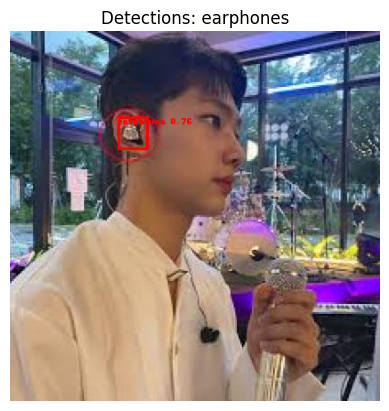


0: 640x640 1 earphones, 8.4ms
Speed: 2.6ms preprocess, 8.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.7934885025024414


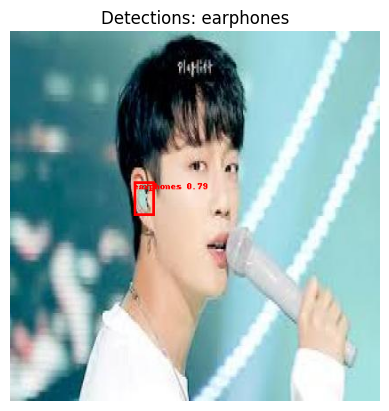


0: 640x640 1 earphones, 7.5ms
Speed: 2.4ms preprocess, 7.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.818204402923584


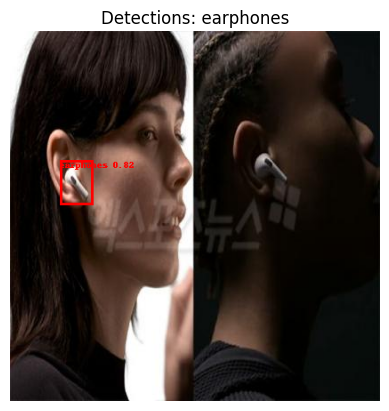


0: 640x640 1 earphones, 7.4ms
Speed: 2.6ms preprocess, 7.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.8673477172851562


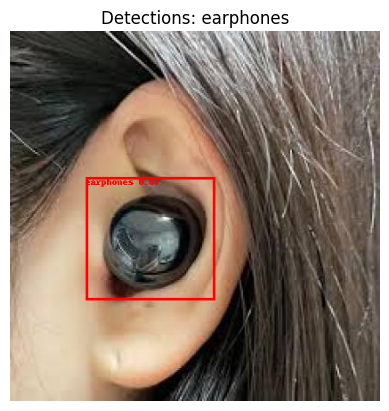


0: 640x640 1 earphones, 7.9ms
Speed: 2.8ms preprocess, 7.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.6864615678787231


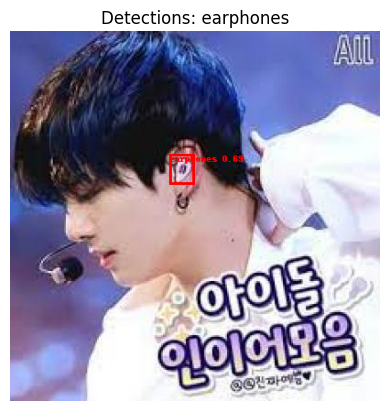


0: 640x640 (no detections), 8.3ms
Speed: 2.7ms preprocess, 8.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


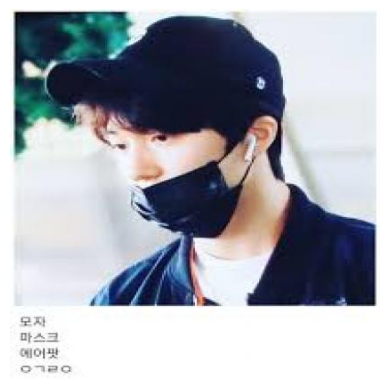


0: 640x640 1 earphones, 8.7ms
Speed: 3.4ms preprocess, 8.7ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.8282766938209534


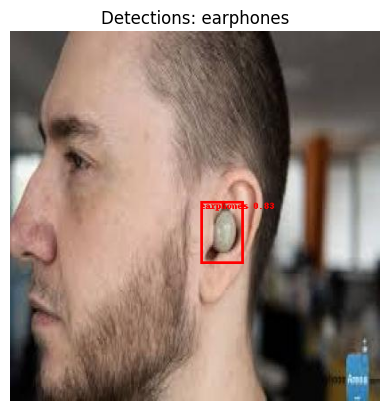


0: 640x640 1 earphones, 7.4ms
Speed: 3.3ms preprocess, 7.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.8992060422897339


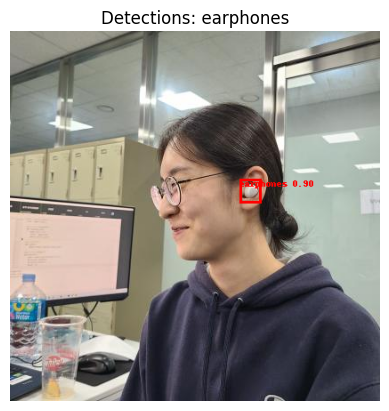


0: 640x640 1 earphones, 7.7ms
Speed: 2.5ms preprocess, 7.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.7457129955291748


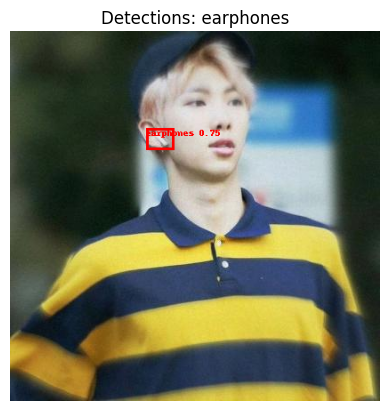


0: 640x640 (no detections), 7.4ms
Speed: 2.7ms preprocess, 7.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


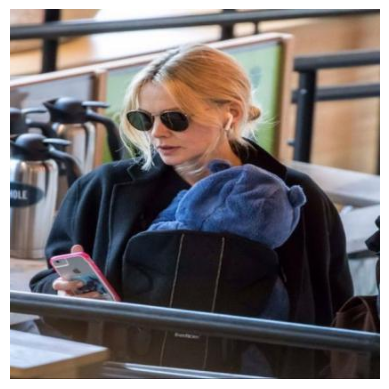


0: 640x640 (no detections), 8.8ms
Speed: 3.4ms preprocess, 8.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


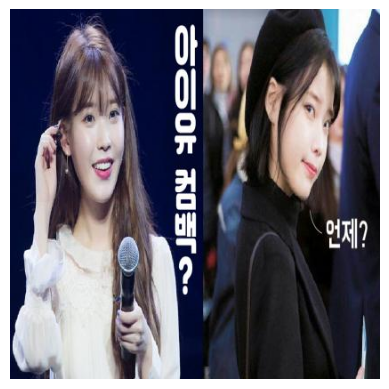


0: 640x640 1 earphones, 8.9ms
Speed: 3.4ms preprocess, 8.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.7365522980690002


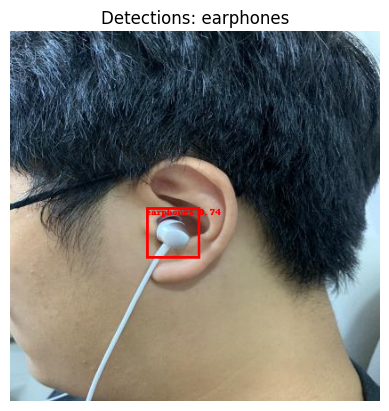


0: 640x640 1 earphones, 7.6ms
Speed: 2.7ms preprocess, 7.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.6380425095558167


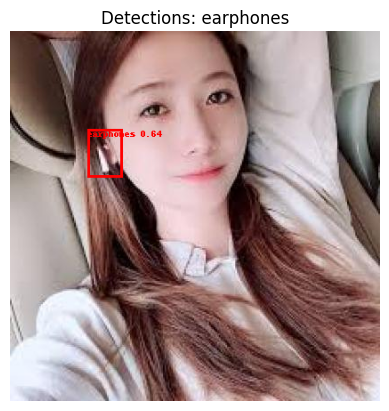


0: 640x640 3 earphoness, 7.5ms
Speed: 2.6ms preprocess, 7.5ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Detected earphones with confidence 0.6225132346153259
Detected earphones with confidence 0.611675500869751
Detected earphones with confidence 0.3894721269607544


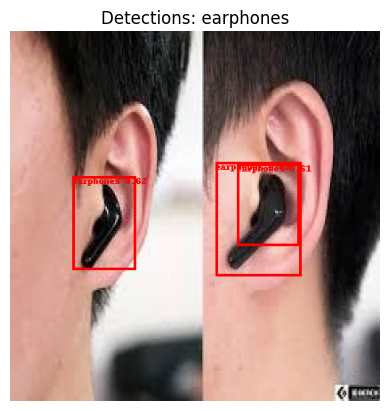